In [1]:
from legend_plot_style import LEGENDPlotStyle as lps

In [2]:
lps.use('legend_talks')

In [3]:
!pip install fastparquet

In [4]:
import os
import pandas as pd
import numpy  as np

import matplotlib.pyplot as plt
import matplotlib.dates  as mdates

from datetime   import datetime, timezone
from legendmeta import LegendMetadata

lmeta = LegendMetadata('/Users/romoluque_c/Repositories/legend-metadata/')

In [5]:
import warnings
warnings.filterwarnings("ignore")

In [6]:
data_path = '/Users/romoluque_c/LEGEND/Event_rate_analysis_TAUP/data_test/skimmed_files/'
def read_and_concat_data_parquet(group, irun, frun, path=data_path):
    return pd.read_parquet(f'{path}/{group}_r{irun:03d}_to_r{frun:03d}.parquet')

data_p03 = read_and_concat_data_parquet('p03', 0, 5)
data_p04 = read_and_concat_data_parquet('p04', 0, 3)
data_p06 = read_and_concat_data_parquet('p06', 0, 6)
data_p07 = read_and_concat_data_parquet('p07', 1, 7)

## Express timestamps in seconds
data_p03.index = pd.to_datetime(data_p03.index, unit='s')
data_p04.index = pd.to_datetime(data_p04.index, unit='s')
data_p06.index = pd.to_datetime(data_p06.index, unit='s')
data_p07.index = pd.to_datetime(data_p07.index, unit='s')

dt    = datetime(2023, 4, 22, 5, 54, 22, tzinfo=timezone.utc)
chmap = lmeta.hardware.configuration.channelmaps.on(dt)

In [7]:
channel_dict = {}
for channel_name, channel_data in chmap.items():
    try:
        channel_dict[channel_data['daq']['rawid']] = (lmeta.channelmap(dt)[channel_name].type,
                                                      channel_name,
                                                      lmeta.channelmap(dt)[channel_name].production['mass_in_g'],
                                                      lmeta.channelmap(dt)[channel_name].location  ['string'],
                                                      lmeta.channelmap(dt)[channel_name].location  ['position'])
    except:
        continue

In [8]:
## Add detector type, channel name and detector mass to dataframe according to the channel id

channel_df = pd.DataFrame.from_dict(channel_dict, orient='index', columns=['det_type', 'channel_name', 'mass', 'string', 'position'])
data_p03   = pd.merge(data_p03, channel_df, left_on='energy_id', right_index=True, how='left')
data_p04   = pd.merge(data_p04, channel_df, left_on='energy_id', right_index=True, how='left')
data_p06   = pd.merge(data_p06, channel_df, left_on='energy_id', right_index=True, how='left')
data_p07   = pd.merge(data_p07, channel_df, left_on='energy_id', right_index=True, how='left')

In [9]:
def data_selection(data):
    return data[(data.is_pulser        == False) & 
                (data.is_baseline      == False) & 
                (data.is_muon_tagged   == False) & 
                (data.is_valid_channel == True)  & 
                (data.multiplicity     == 1)     &
                (data.is_physical      == True)]

def data_selection_no_mult(data):
    return data[(data.is_pulser        == False) & 
                (data.is_baseline      == False) & 
                (data.is_muon_tagged   == False) & 
                (data.is_valid_channel == True)  &
                (data.is_physical      == True)]

def resample_df(df, timestamp='H'): ## returns the event rates in mHz (evt rate per hour /3600 sec *1000 mHz)
    event_rate_df        = df.resample(timestamp).size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    return event_rate_df_series

def resample_df_norm_mass(df, timestamp='H'): ## returns the event rates in mHz normalizing with the mass of each detector
    event_rate_df        = df.resample(timestamp).size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    summed_mass          = df.resample(timestamp).sum().mass/1000 #transform to kg
    event_rate_norm      = event_rate_df_series/summed_mass
    return event_rate_norm.fillna(0)

def resample_df_norm_keV_kg(df, timestamp='H'): ## returns the event rates in mHz*keV/kg
    event_rate_df        = df.resample(timestamp).size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    summed_mass          = df.resample(timestamp).sum().mass/1000 #transform to kg
    summed_energy        = df.resample(timestamp).sum().energy #keV
    event_rate_norm      = (event_rate_df_series*summed_energy)/summed_mass
    return event_rate_norm.fillna(0)

In [10]:
all_cuts = [('is_pulser',        False),
            ('is_baseline',      False),
            ('is_muon_tagged',   False),
            ('is_valid_channel', True),
            ('multiplicity',     1),
            ('is_physical',      True)]

colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
legend_colors = np.array(list(lps.colors.keys()))

vert_line_date     = pd.to_datetime('2023-04-14')
vert_line_datetime = pd.to_datetime('2023-04-14 8:00')
vert_line_num      = mdates.date2num(vert_line_datetime)

In [11]:
def period_dates(df):
    dates = pd.to_datetime(df.index[[0, -1]], unit='s')
    return dates[0], dates.mean(), dates[1]

p03_idate, p03_mdate, p03_fdate = period_dates(data_p03)
p04_idate, p04_mdate, p04_fdate = period_dates(data_p04)
p06_idate, p06_mdate, p06_fdate = period_dates(data_p06)
p07_idate, p07_mdate, p07_fdate = period_dates(data_p07)

In [12]:
data_p03_filt = data_selection(data_p03)
data_p04_filt = data_selection(data_p04)
data_p06_filt = data_selection(data_p06)
data_p07_filt = data_selection(data_p07)

data_p03_no_mult = data_selection_no_mult(data_p03)
data_p04_no_mult = data_selection_no_mult(data_p04)
data_p06_no_mult = data_selection_no_mult(data_p06)
data_p07_no_mult = data_selection_no_mult(data_p07)

data_p03_Getrig = data_p03[~(data_p03.energy_id == 0)]
data_p04_Getrig = data_p04[~(data_p04.energy_id == 0)]
data_p06_Getrig = data_p06[~(data_p06.energy_id == 0)]
data_p07_Getrig = data_p07[~(data_p07.energy_id == 0)]

### Join p3 and p4
data         = pd.concat([data_p03,         data_p04,         data_p06,         data_p07],         verify_integrity=True)
data_filt    = pd.concat([data_p03_filt,    data_p04_filt,    data_p06_filt,    data_p07_filt],    verify_integrity=True)
data_no_mult = pd.concat([data_p03_no_mult, data_p04_no_mult, data_p06_no_mult, data_p07_no_mult], verify_integrity=True)
data_Getrig  = pd.concat([data_p03_Getrig,  data_p04_Getrig,  data_p06_Getrig,  data_p07_Getrig],  verify_integrity=True)

data_series        = resample_df(data)
data_filt_series   = resample_df(data_filt)
data_Getrig_series = resample_df(data_Getrig)

data_days_series      = resample_df(data,      timestamp='D')
data_days_filt_series = resample_df(data_filt, timestamp='D')

data_4h_series      = resample_df(data,      timestamp='4H')
data_4h_filt_series = resample_df(data_filt, timestamp='4H')

In [13]:
data_all_periods      = [data_p03,      data_p04,      data_p06,      data_p07]
data_all_periods_filt = [data_p03_filt, data_p04_filt, data_p06_filt, data_p07_filt]

In [14]:
legend_colors

array(['legend_grey', 'legend_blue', 'legend_darkblue', 'legend_orange',
       'legend_green', 'legend_violet', 'legend_gold', 'legend_darkgreen',
       'legend_purple', 'black', 'red', 'yellow', 'green', 'purple',
       'silver', 'salmon', 'violet', 'darkblue', 'grey', 'gray',
       '1sigma_green', '2sigma_yellow', 'mint', 'forestgreen', 'orange',
       'darkred', 'sand', 'lightgrey', 'lightgray', 'jet', 'teal'],
      dtype='<U16')

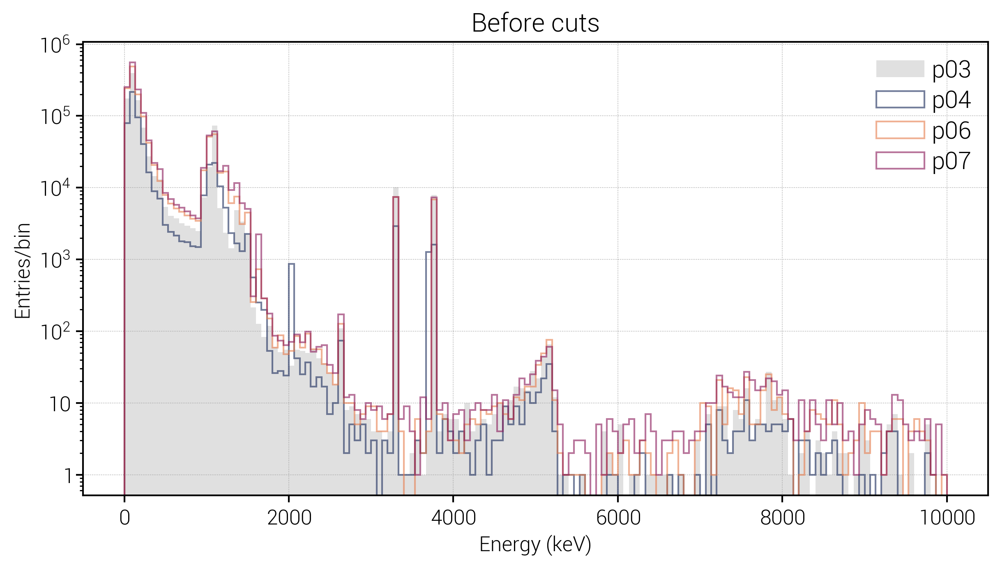

In [15]:
fig, ax = lps.subplots()
for period, data_sel, col in zip([3, 4, 6, 7], data_all_periods, ['legend_grey', 'legend_darkblue', 'orange', 'purple']):
    if period ==3:
        data_sel.energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.6, label=f'p0{period}', color=lps.colors[col])
    else:
        data_sel.energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.6, label=f'p0{period}', histtype='step', color=lps.colors[col])
plt.title('Before cuts', fontsize=15)
plt.xlabel('Energy (keV)')
plt.ylabel('Entries/bin')
plt.legend(loc=1, fontsize=14);

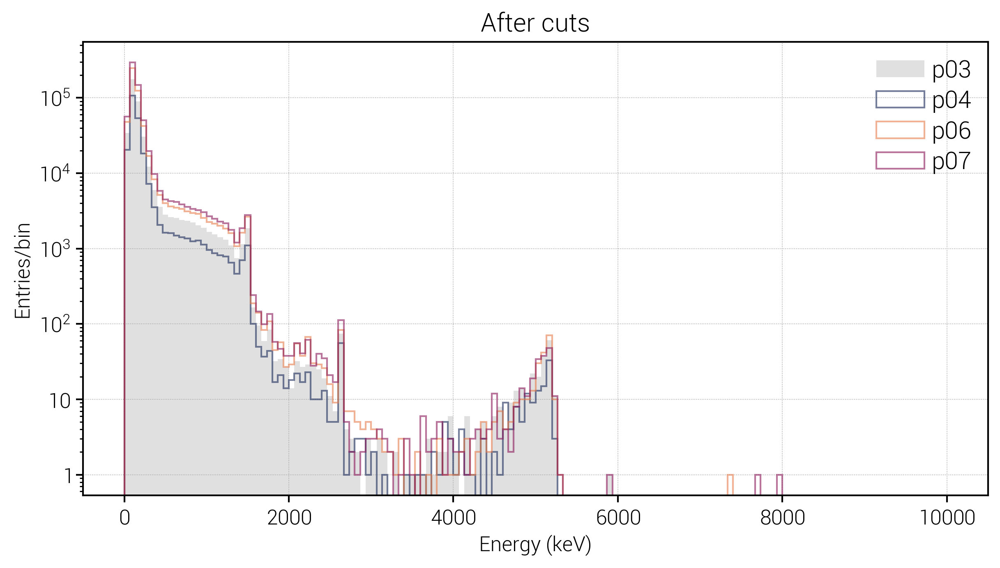

In [16]:
fig, ax = lps.subplots()
for period, data_sel, col in zip([3, 4, 6, 7], data_all_periods_filt, ['legend_grey', 'legend_darkblue', 'orange', 'purple']):
    if period ==3:
        data_sel.energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.6, label=f'p0{period}', color=lps.colors[col])
    else:
        data_sel.energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.6, label=f'p0{period}', histtype='step', color=lps.colors[col])
plt.title('After cuts', fontsize=15)
plt.xlabel('Energy (keV)')
plt.ylabel('Entries/bin')
plt.legend(loc=1, fontsize=14);

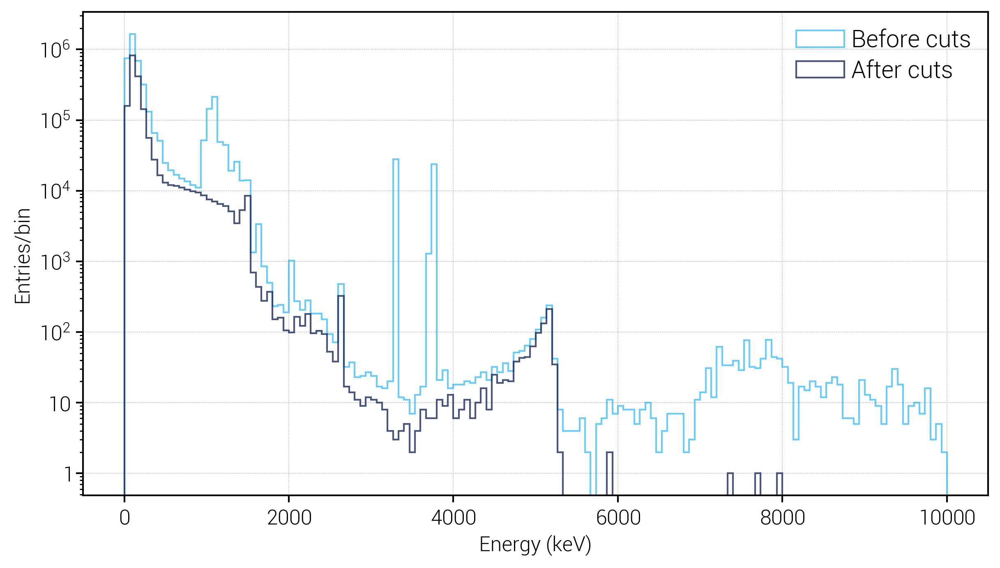

In [17]:
fig, ax = lps.subplots()
data     .energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.6, label='Before cuts', histtype='step', color=lps.colors['legend_blue'])
data_filt.energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.8, label='After cuts' , histtype='step', color=lps.colors['legend_darkblue'])
#plt.title('Ge energy')
plt.xlabel('Energy (keV)')
plt.ylabel('Entries/bin')
plt.legend(loc=1, fontsize=14);

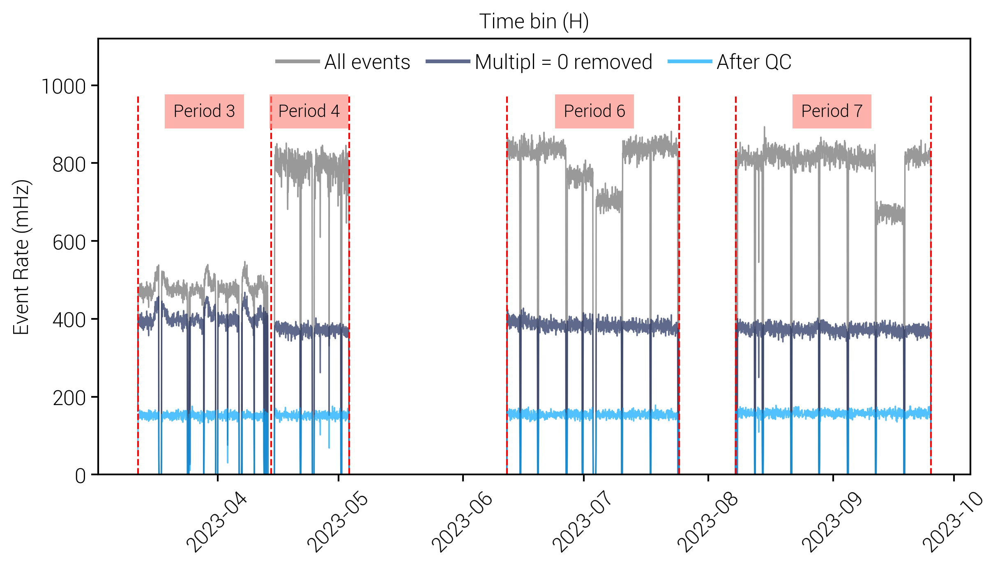

In [18]:
fig, ax = lps.subplots()
ax.plot(data_series       .index, data_series,        linewidth=0.8, color='grey', alpha=0.8, label='All events')
ax.plot(data_Getrig_series.index, data_Getrig_series, linewidth=0.8, color=lps.colors['legend_darkblue'], alpha=0.7, label='Multipl = 0 removed')
ax.plot(data_filt_series  .index, data_filt_series,   linewidth=0.8, color=lps.colors['legend_blue'],     alpha=0.7, label='After QC')

for date in [p03_idate, p03_fdate+(p04_idate-p03_fdate)/2, p04_fdate, p06_idate, p06_fdate, p07_idate, p07_fdate]:
    plt.axvline(x=date, color='r', linestyle='--', ymin=0, ymax=0.87)
for date, period in zip(['2023-03-21', '2023-04-16', '2023-06-26', '2023-08-24'], [3, 4, 6, 7]):
    plt.text(pd.to_datetime(date), 920, f'Period {period}', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=10)
    
ax.set_title('Time bin (H)')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=3, fontsize=12, loc='upper center')
for line in leg.get_lines():
    line.set_linewidth(2.2)

plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.ylim(0, 1120)
plt.show()

In [19]:
p04_fdate, p06_idate, p07_fdate

(Timestamp('2023-05-03 15:50:03.133720576'),
 Timestamp('2023-06-11 22:27:57.674320384'),
 Timestamp('2023-09-25 07:08:59.180084992'))

In [20]:
p03_r000 = ['2023-03-12 04:33', '2023-03-17 09:05']
p03_r001 = ['2023-03-18 01:51', '2023-03-24 11:58']
p03_r002 = ['2023-03-24 20:59', '2023-03-31 11:39']
p03_r003 = ['2023-04-01 01:27', '2023-04-06 15:50']
p03_r004 = ['2023-04-06 23:55', '2023-04-12 11:06']
p03_r005 = ['2023-04-12 17:14', '2023-04-13 11:44']
p04_r000 = ['2023-04-15 03:35', '2023-04-21 11:25']
p04_r001 = ['2023-04-21 17:49', '2023-04-24 12:49']
p04_r002 = ['2023-04-24 18:56', '2023-05-01 14:13']
p04_r003 = ['2023-05-01 20:59', '2023-05-03 15:04']
p04_r006 = ['2023-05-09 15:17', '2023-05-12 11:48']
p06_r000 = ['2023-06-11 22:27', '2023-06-19 11:42']
p06_r001 = ['2023-06-19 18:27', '2023-06-26 14:12']
p06_r002 = ['2023-06-26 21:51', '2023-07-03 19:43']
p06_r003 = ['2023-07-04 01:50', '2023-07-10 09:08']
p06_r004 = ['2023-07-10 15:18', '2023-07-17 12:13']
p06_r005 = ['2023-07-17 17:51', '2023-07-24 09:04']
p06_r006 = ['2023-07-24 14:56', '2023-07-24 15:56']
#p07_r000 = ['2023-07-31 16:58', '2023-08-07 08:47']
p07_r001 = ['2023-08-07 18:42', '2023-08-14 08:51']
p07_r002 = ['2023-08-14 15:45', '2023-08-21 11:03']
p07_r003 = ['2023-08-21 18:03', '2023-08-28 09:16']
p07_r004 = ['2023-08-28 15:49', '2023-09-04 11:40']
p07_r005 = ['2023-09-04 19:02', '2023-09-11 11:10']
p07_r006 = ['2023-09-11 17:38', '2023-09-18 12:48']
p07_r007 = ['2023-09-18 19:45', '2023-09-25 07:00']

In [21]:
allp_ilines = ['2023-03-12 04:33', '2023-03-18 01:51', '2023-03-24 20:59', '2023-04-01 01:27', '2023-04-06 23:55', '2023-04-12 17:14', '2023-04-15 03:35', '2023-04-21 17:49', '2023-04-24 18:56', '2023-05-01 20:59', '2023-05-09 15:17', '2023-06-11 22:27', '2023-06-19 18:27', '2023-06-26 21:51', '2023-07-04 01:50', '2023-07-10 15:18', '2023-07-17 17:51', '2023-07-24 14:56', '2023-08-07 18:42', '2023-08-14 15:45', '2023-08-21 18:03', '2023-08-28 15:49', '2023-09-04 19:02', '2023-09-11 17:38', '2023-09-18 19:45'] #p07 r000: '2023-07-31 16:58', 
allp_flines = ['2023-03-17 09:05', '2023-03-24 11:58', '2023-03-31 11:39', '2023-04-06 15:50', '2023-04-12 11:06', '2023-04-13 11:44', '2023-04-21 11:25', '2023-04-24 12:49', '2023-05-01 14:13', '2023-05-03 15:04', '2023-05-12 11:48', '2023-06-19 11:42', '2023-06-26 14:12', '2023-07-03 19:43', '2023-07-10 09:08', '2023-07-17 12:13', '2023-07-24 09:04', '2023-07-24 15:56', '2023-08-14 08:51', '2023-08-21 11:03', '2023-08-28 09:16', '2023-09-04 11:40', '2023-09-11 11:10', '2023-09-18 12:48', '2023-09-25 07:00'] #p07 r000: '2023-08-07 08:47', 

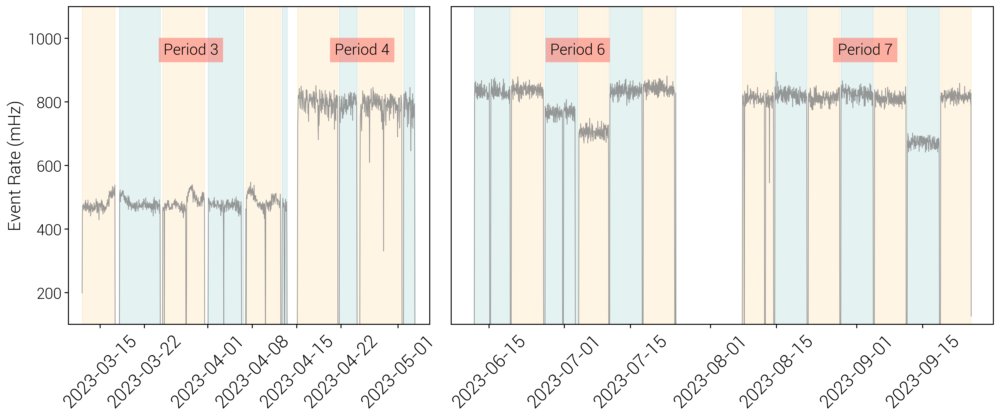

In [22]:
fig, axs = lps.subplots(1, 2, figsize=(14.5, 6), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    ax.plot(data_series       .index, data_series,        linewidth=0.8, color='grey', alpha=0.8, label='All events')
    ax.tick_params(axis='x', labelsize=19, rotation=45)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_ylim(100, 1100)
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 950, f'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 950, f'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 950, f'Period 6', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 950, f'Period 7', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-07'), pd.to_datetime('2023-09-30'))
axs[1].set_yticks([])

for i, (idate, fdate) in enumerate(zip(allp_ilines, allp_flines)):
    if (i % 2)==1:
        color='teal'
    else:
        color='orange'
    axs[0].axvspan(pd.to_datetime(idate), pd.to_datetime(fdate), color=color, alpha=0.1)
    axs[1].axvspan(pd.to_datetime(idate), pd.to_datetime(fdate), color=color, alpha=0.1)


plt.show()

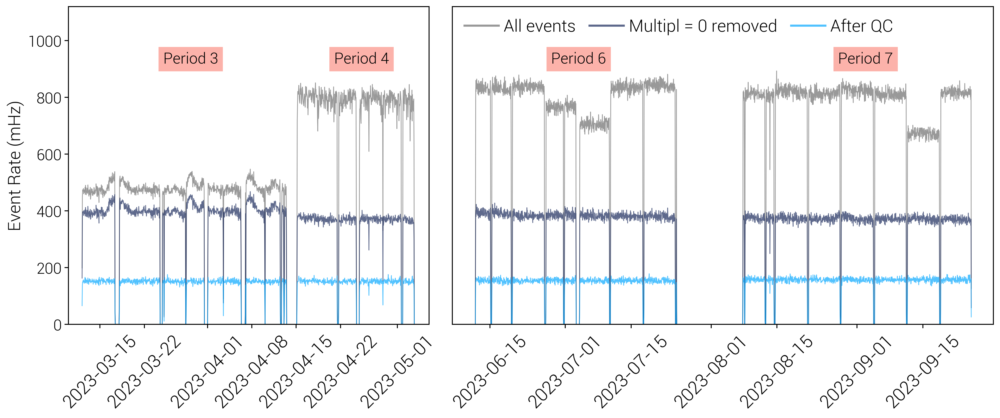

In [23]:
fig, axs = lps.subplots(1, 2, figsize=(14.5, 6), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    ax.plot(data_series       .index, data_series,        linewidth=0.8, color='grey', alpha=0.8, label='All events')
    ax.plot(data_Getrig_series.index, data_Getrig_series, linewidth=0.8, color=lps.colors['legend_darkblue'], alpha=0.7, label='Multipl = 0 removed')
    ax.plot(data_filt_series  .index, data_filt_series,   linewidth=0.8, color=lps.colors['legend_blue'],     alpha=0.7, label='After QC')
    #ax.set_xticklabels(ax.get_xticklabels(), rotation=45, fontsize=19)
    ax.tick_params(axis='x', labelsize=19, rotation=45)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_ylim(0, 1120)
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 920, f'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 920, f'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 920, f'Period 6', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 920, f'Period 7', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-07'), pd.to_datetime('2023-09-30'))
axs[1].set_yticks([])
leg = axs[1].legend(ncol=3, fontsize=18)
for line in leg.get_lines():
    line.set_linewidth(2.2)


plt.show()

### Apply cuts individually:

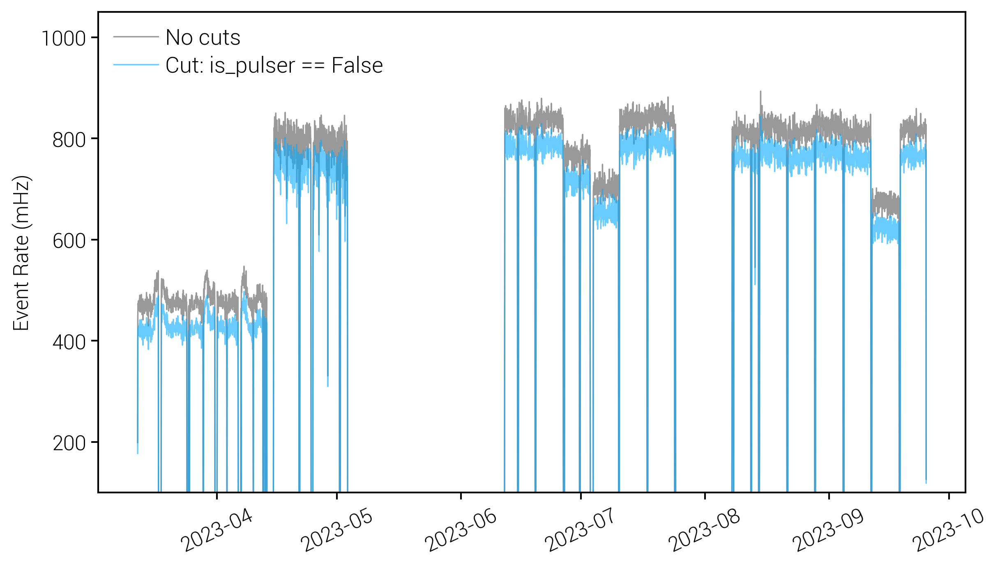

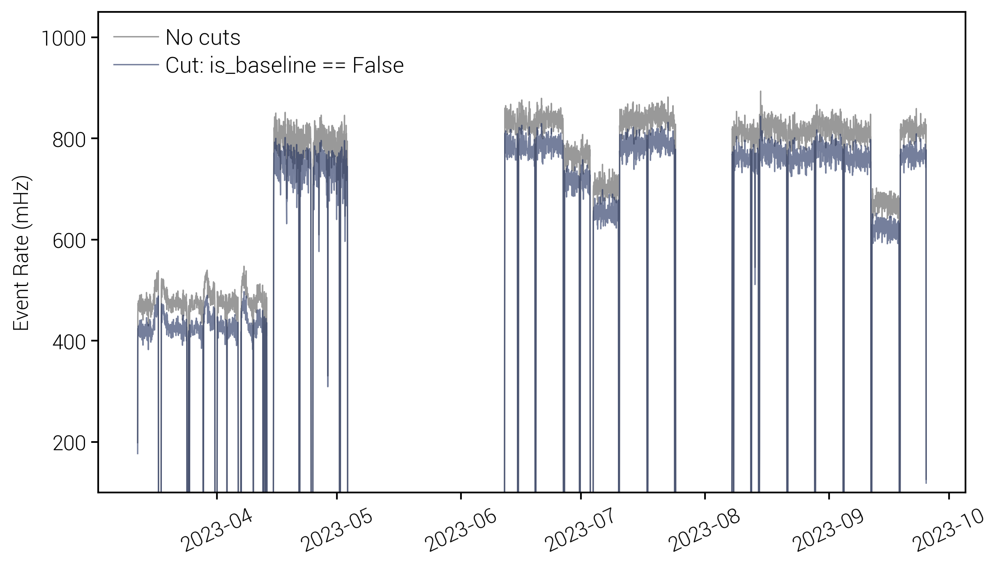

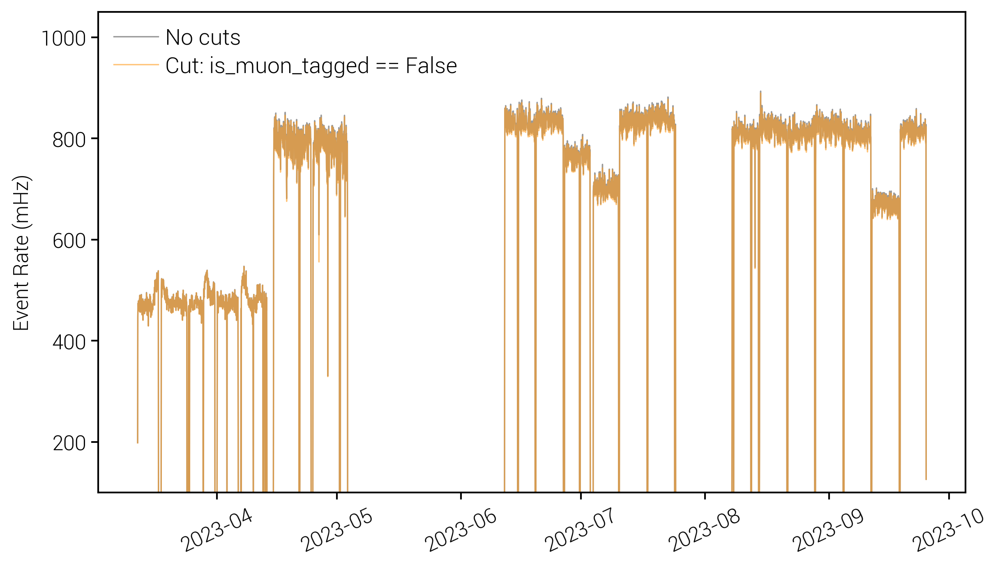

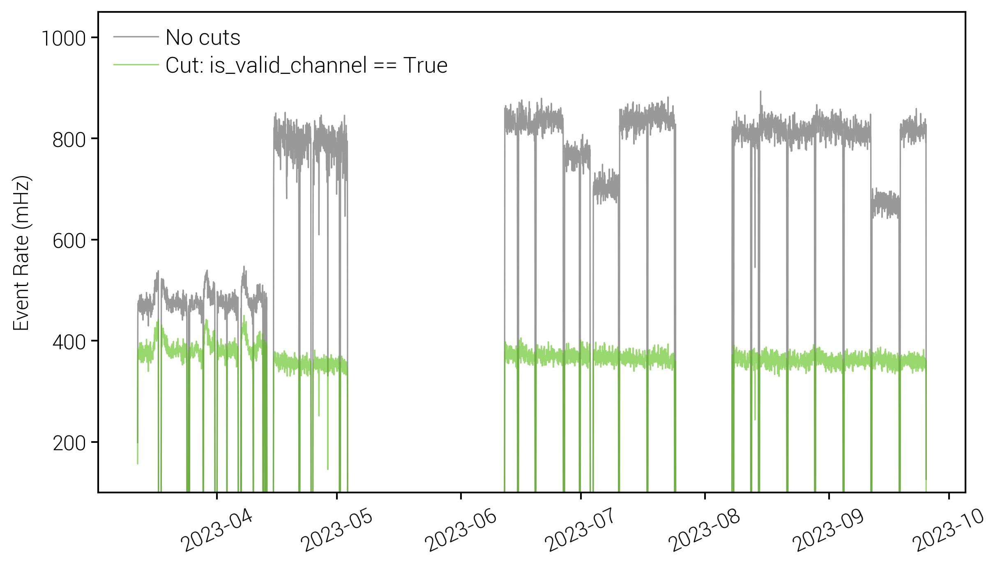

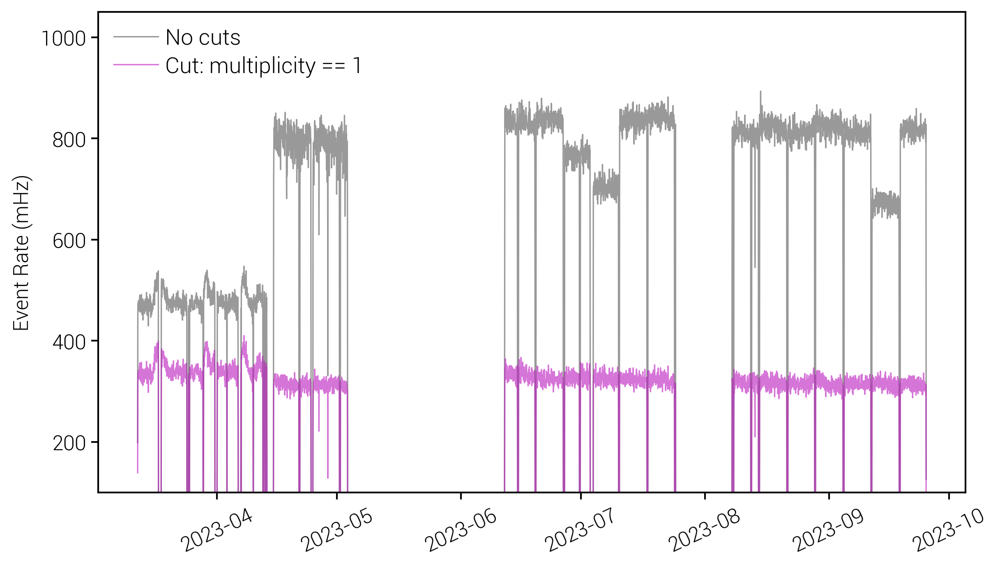

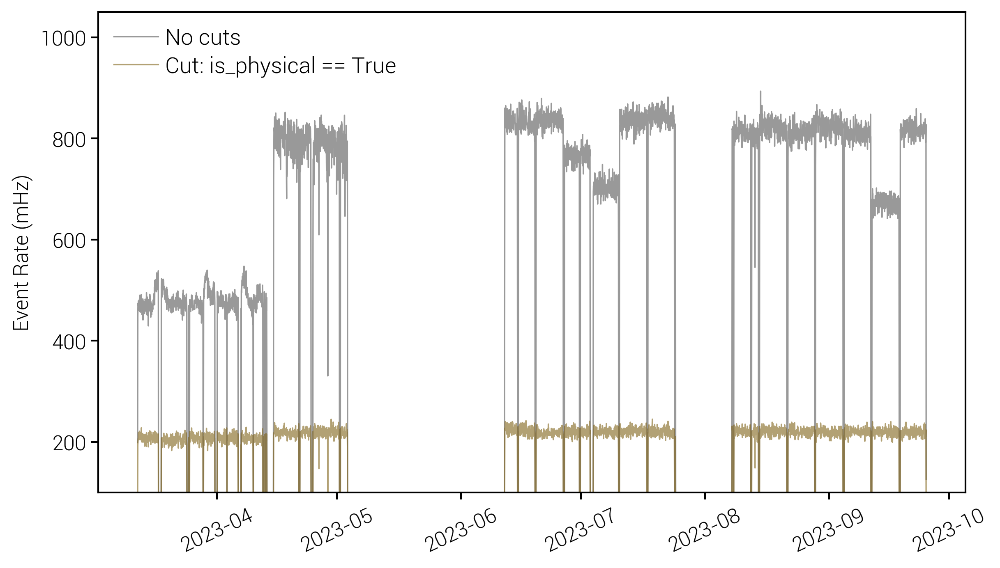

In [24]:
for (cut, val), col in zip(all_cuts, legend_colors[1:]):
    fig, ax = lps.subplots()
    ax.plot(data_series.index, data_series, linewidth=0.8, color='grey', alpha=0.8, label='No cuts')
    #ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')

    df_test        = data[data[cut]==val]
    df_test_series = resample_df(df_test)

    ax.plot(df_test_series.index,  df_test_series,  linewidth=0.8, alpha=0.6, color=lps.colors[col], label=f'Cut: {str(cut)} == {str(val)}')
    ax.set_title(f'')
    ax.set_ylabel('Event Rate (mHz)')
    ax.legend(ncol=1, fontsize=13, loc='upper left')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=25)
    ax.set_ylim(100, 1050)
    plt.show()

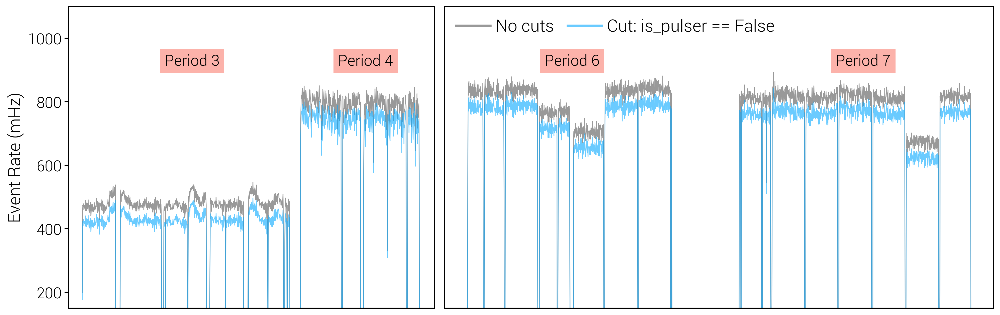

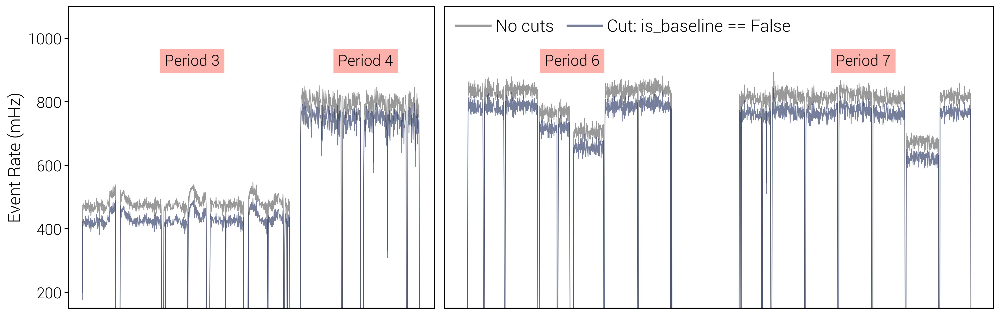

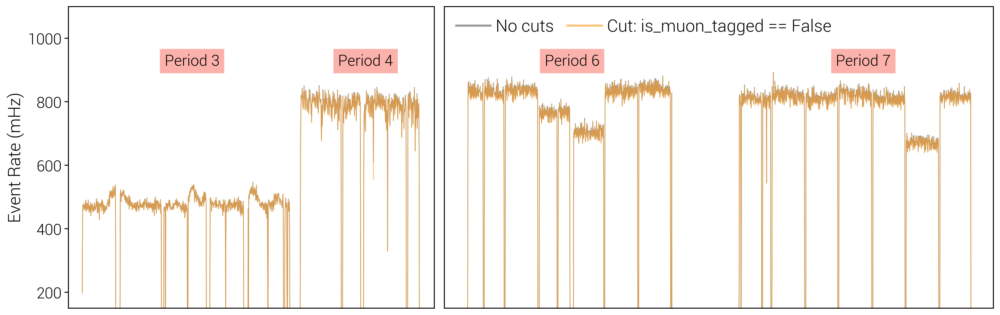

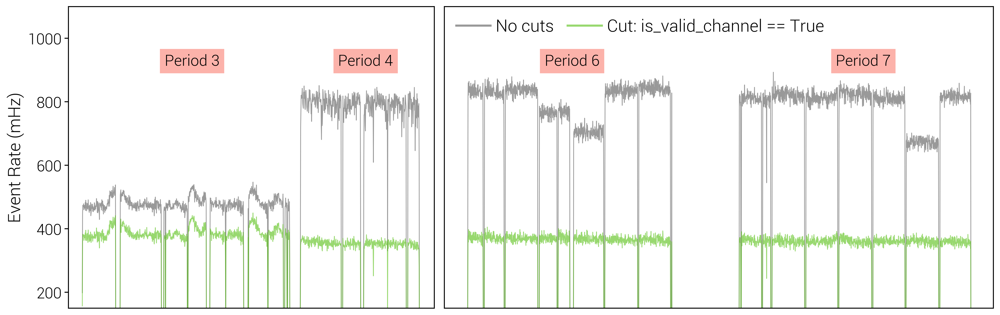

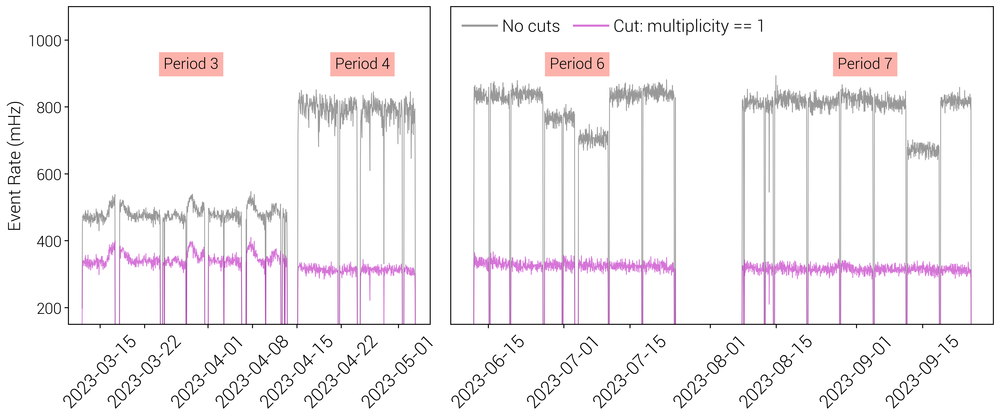

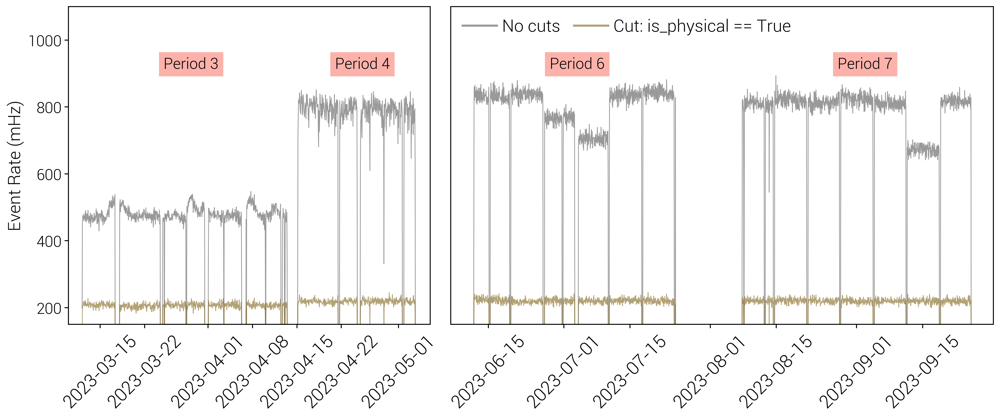

In [25]:
for i, ((cut, val), col) in enumerate(zip(all_cuts, legend_colors[1:])):
    df_test        = data[data[cut]==val]
    df_test_series = resample_df(df_test)

    if i >= len(all_cuts)-2:
        fig, axs = lps.subplots(1, 2, figsize=(14.5, 6), gridspec_kw={'width_ratios': [1, 1.5]})
    else:
        fig, axs = lps.subplots(1, 2, figsize=(14.5, 4.5), gridspec_kw={'width_ratios': [1, 1.5]})
        
    for ax in axs:
        ax.plot(data_series   .index, data_series,     linewidth=0.8, alpha=0.8, color='grey', label='No cuts')
        ax.plot(df_test_series.index, df_test_series,  linewidth=0.8, alpha=0.6, color=lps.colors[col], label=f'Cut: {str(cut)} == {str(val)}')
        ax.tick_params(axis='x', labelsize=19, rotation=45)
        ax.tick_params(axis='y', labelsize=16)
        ax.set_ylim(150, 1100)
        if i < len(all_cuts)-2:
            ax.set_xticks([])

    axs[0].text(pd.to_datetime('2023-03-25'), 915, f'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
    axs[0].text(pd.to_datetime('2023-04-21'), 915, f'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
    
    axs[1].text(pd.to_datetime('2023-06-28'), 915, f'Period 6', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
    axs[1].text(pd.to_datetime('2023-08-28'), 915, f'Period 7', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
    
    #axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
    axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
    axs[1].set_xlim(pd.to_datetime('2023-06-07'), pd.to_datetime('2023-09-30'))
    axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
    axs[1].set_yticks([])
    leg = axs[1].legend(ncol=2, fontsize=18, loc='upper left')
    for line in leg.get_lines():
        line.set_linewidth(2.2)
    plt.tight_layout()
    plt.show()

## Separate with detector types:

In [26]:
nice_det_labels = ['ICPC', 'Coax',   'BEGe', 'PPC']
det_colors      = ['grey', 'yellow', 'red',  'teal']

det_types  = np.array([val[0] for val in channel_dict.values()])
nice_det_name_dict = {'icpc': nice_det_labels[0],
                      'coax': nice_det_labels[1],
                      'bege': nice_det_labels[2],
                      'ppc' : nice_det_labels[3]}

det_colors_leg_style = ['silver', 'legend_blue', 'legend_orange', 'legend_darkblue']

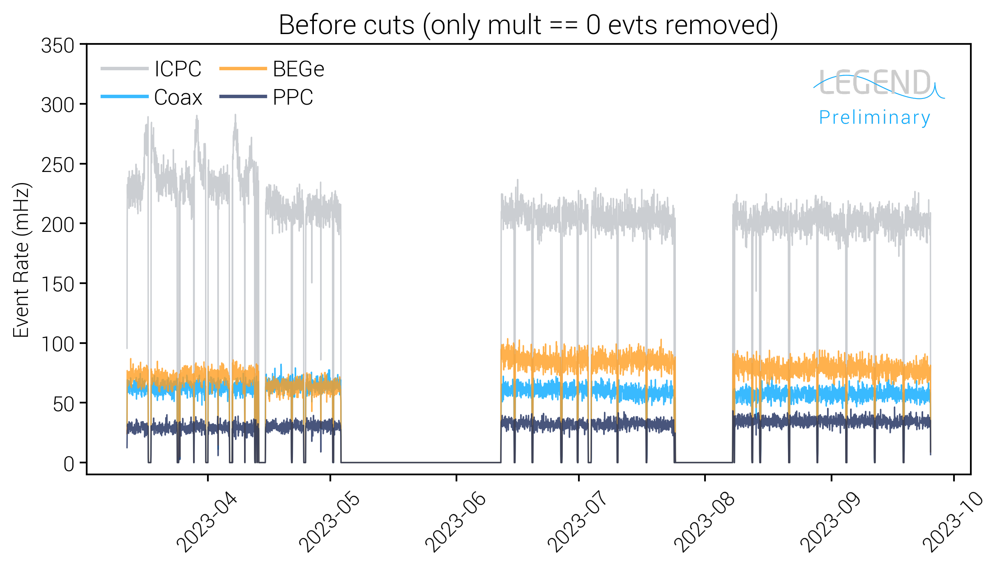

In [27]:
fig, ax = lps.subplots()
det_colors_leg_style = ['silver', 'legend_blue', 'legend_orange', 'legend_darkblue']
for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
    det_lab         = nice_det_name_dict[d_type]
    data_det        = data[data.det_type==d_type]
    data_det_series = resample_df(data_det)
    ax.plot(data_det_series.index, data_det_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_title('Before cuts (only mult == 0 evts removed)', fontsize=16)
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=2, fontsize=13, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)

plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-10, 350)
plt.show()

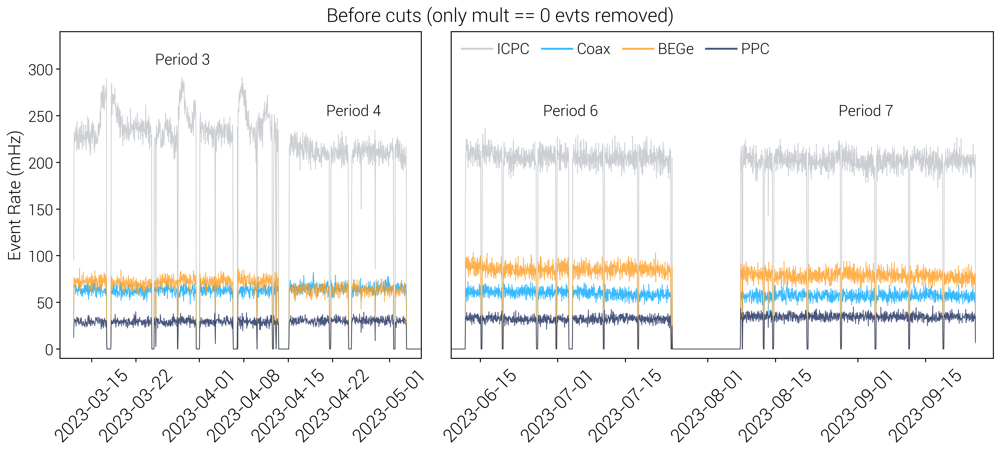

In [28]:
fig, axs = lps.subplots(1, 2, figsize=(14.5, 6.5), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    
    for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
        det_lab         = nice_det_name_dict[d_type]
        data_det        = data[data.det_type==d_type]
        data_det_series = resample_df(data_det)
        ax.plot(data_det_series.index, data_det_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')

    ax.tick_params(axis='x', labelsize=19, rotation=45)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_ylim(-10, 340)
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 305, f'Period 3', fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 250, f'Period 4', fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 250, f'Period 6', fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 250, f'Period 7', fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-09'), pd.to_datetime('2023-09-29'))
axs[1].set_yticks([])

leg = axs[1].legend(ncol=4, fontsize=16, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
    
fig.suptitle('Before cuts (only mult == 0 evts removed)', fontsize=20)

plt.show()

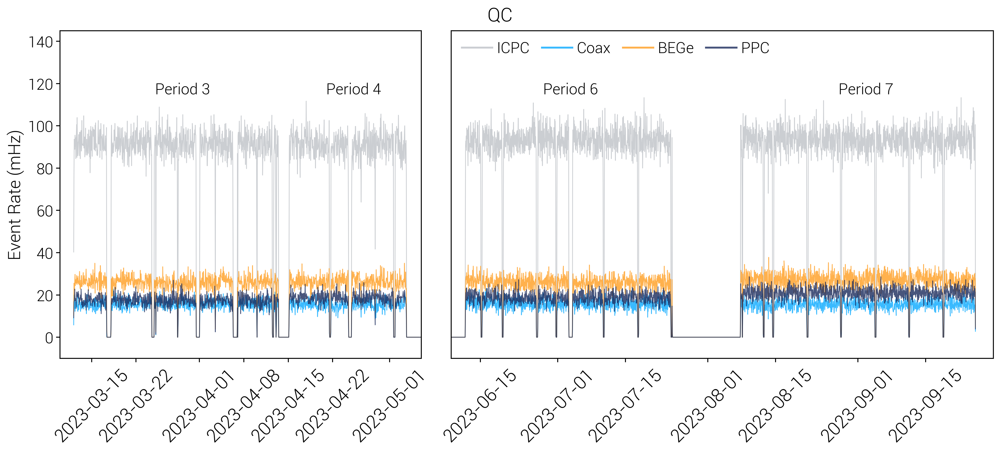

In [29]:
fig, axs = lps.subplots(1, 2, figsize=(14.5, 6.5), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
        det_lab         = nice_det_name_dict[d_type]
        data_filt_det        = data_filt[data_filt.det_type==d_type]
        data_filt_det_series = resample_df(data_filt_det)
        ax.plot(data_filt_det_series.index, data_filt_det_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')

    ax.tick_params(axis='x', labelsize=19, rotation=45)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_ylim(-10, 145)
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 115, f'Period 3', fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 115, f'Period 4', fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 115, f'Period 6', fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 115, f'Period 7', fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-09'), pd.to_datetime('2023-09-29'))
axs[1].set_yticks([])

leg = axs[1].legend(ncol=4, fontsize=16, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
    
fig.suptitle('QC', fontsize=20)

plt.show()

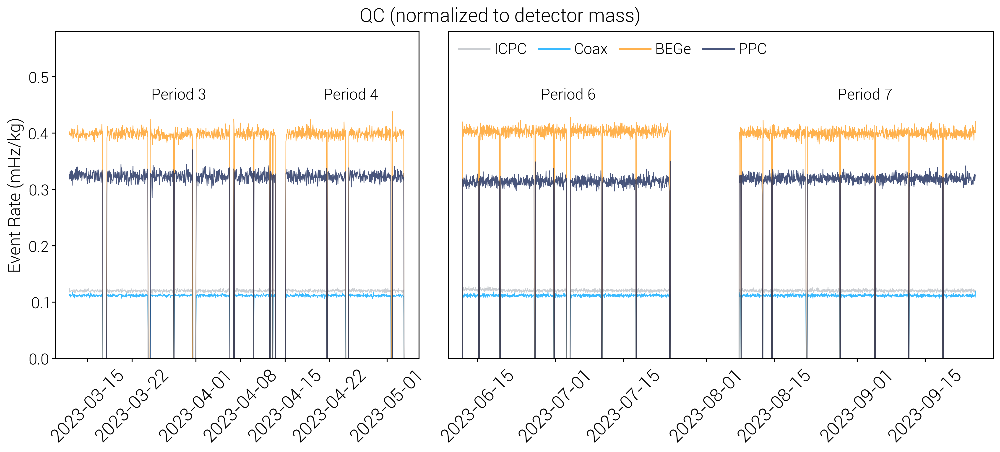

In [30]:
fig, axs = lps.subplots(1, 2, figsize=(14.5, 6.5), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    
    for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
        det_lab              = nice_det_name_dict[d_type]
        data_filt_det        = data_filt[data_filt.det_type==d_type]
        data_filt_det_mass_series = resample_df_norm_mass(data_filt_det)
        ax.plot(data_filt_det_mass_series.index, data_filt_det_mass_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')

    ax.tick_params(axis='x', labelsize=19, rotation=45)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_ylim(0., 0.58)
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 0.46, f'Period 3', fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 0.46, f'Period 4', fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 0.46, f'Period 6', fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 0.46, f'Period 7', fontsize=16)

axs[0].set_ylabel('Event Rate (mHz/kg)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-09'), pd.to_datetime('2023-09-29'))
axs[1].set_yticks([])

leg = axs[1].legend(ncol=4, fontsize=16, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
    
fig.suptitle('QC (normalized to detector mass)', fontsize=20)

plt.show()

### Individual cuts applied to every detector type

--------------------------ICPC----------------------------


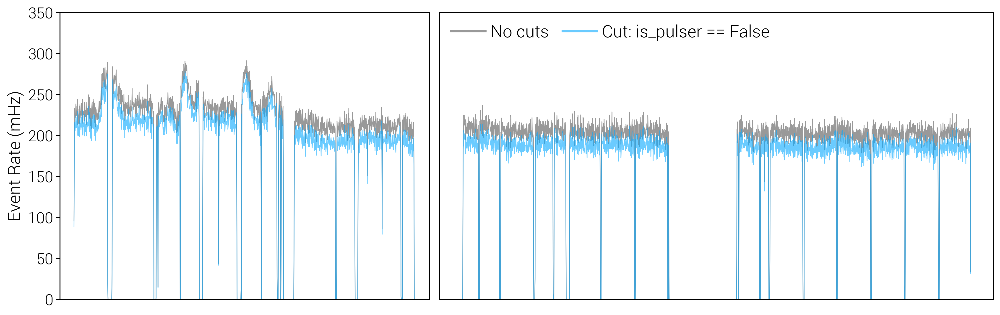

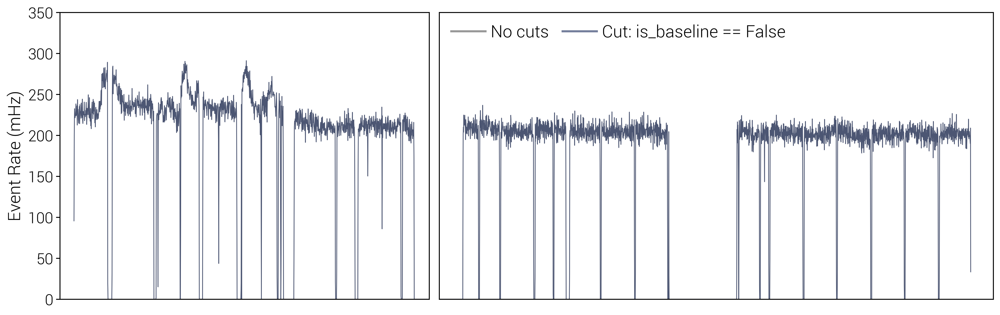

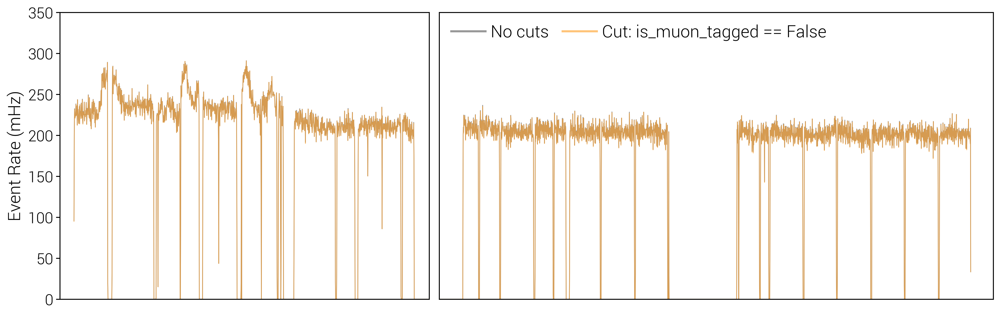

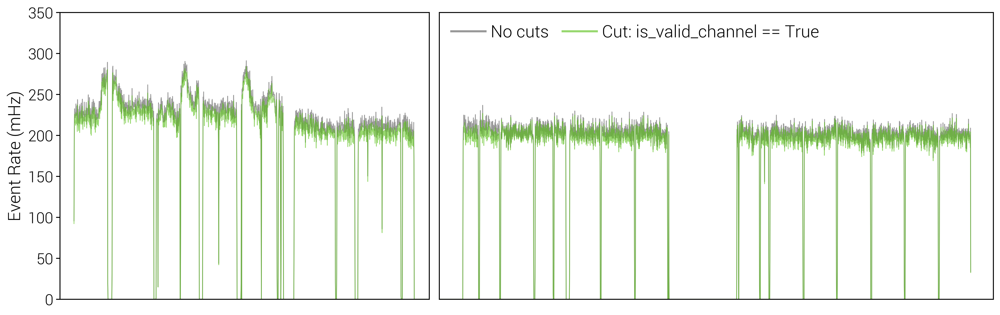

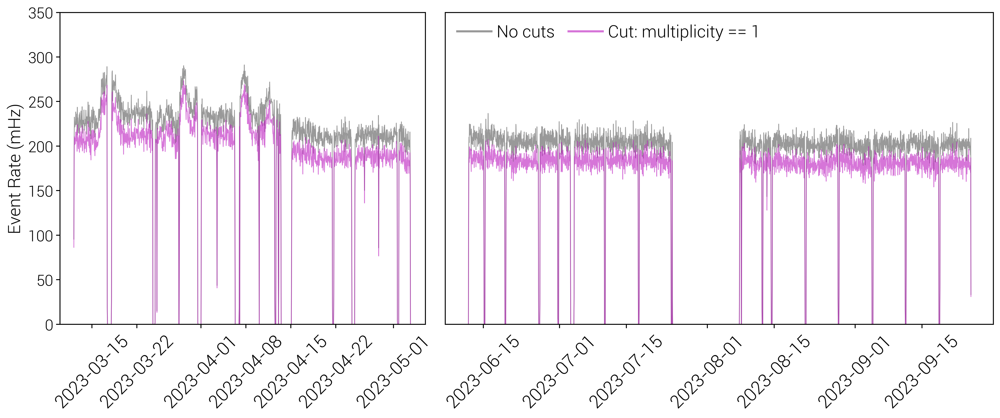

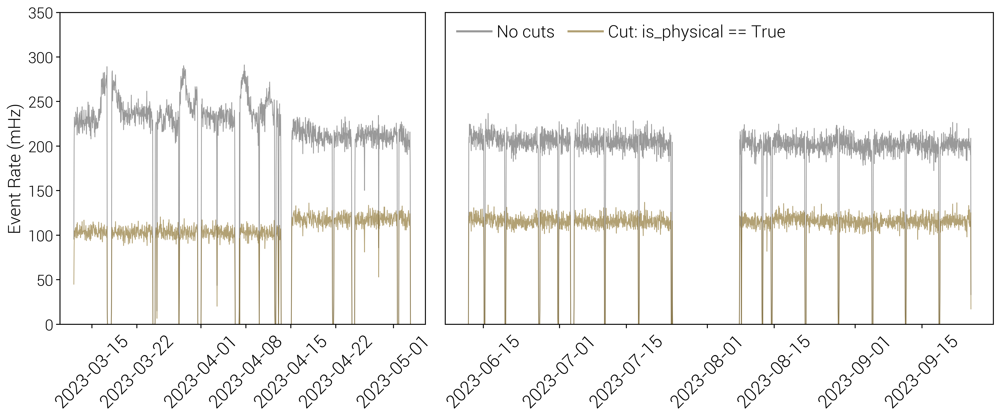

--------------------------Coax----------------------------


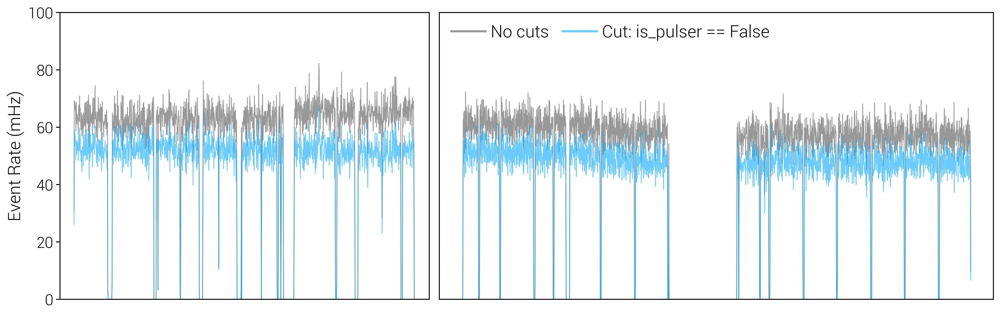

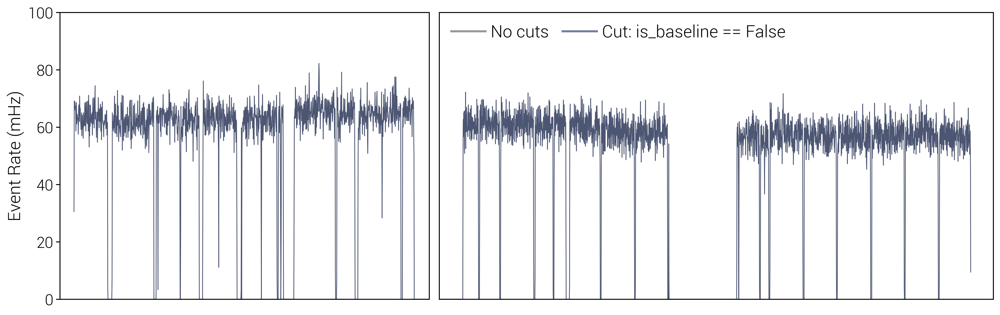

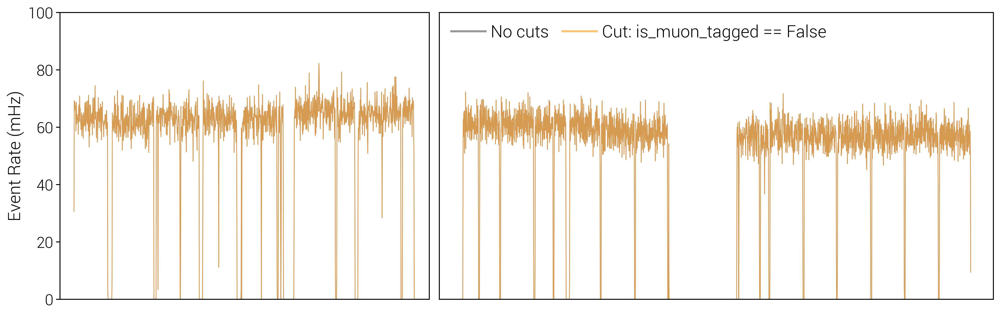

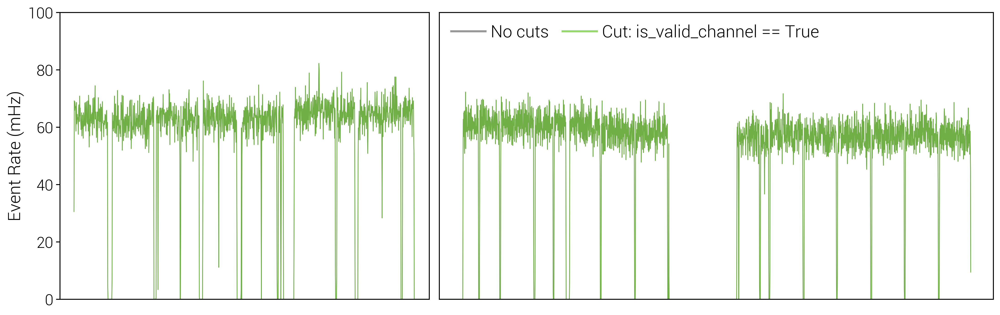

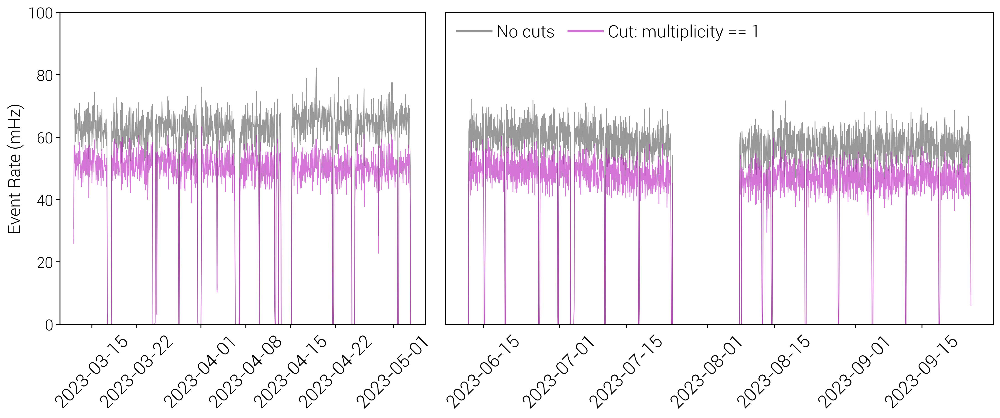

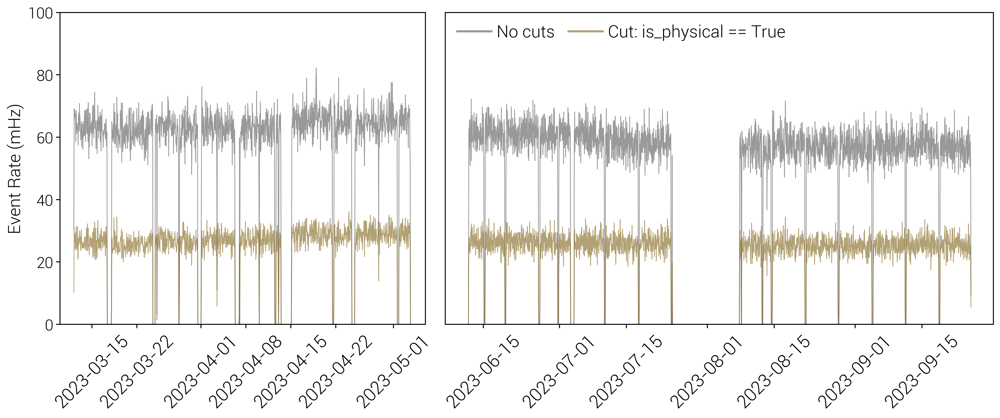

--------------------------BEGe----------------------------


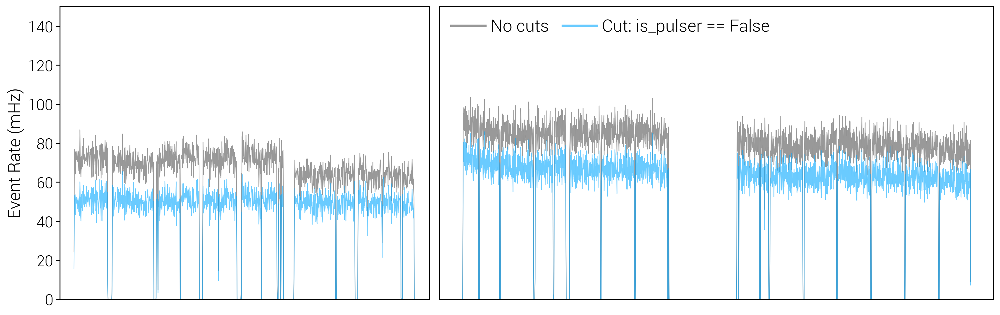

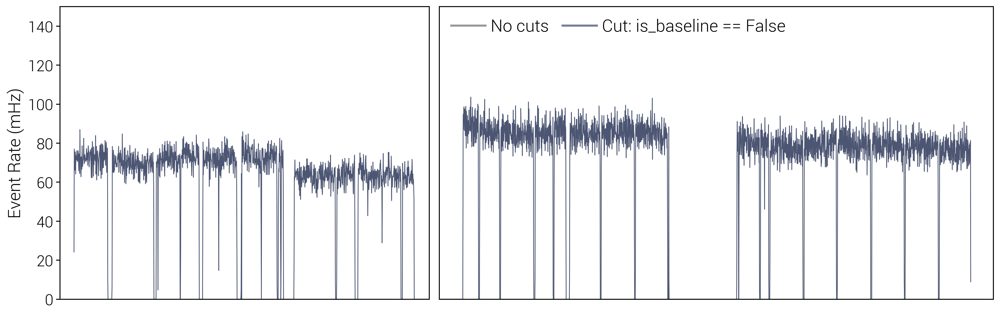

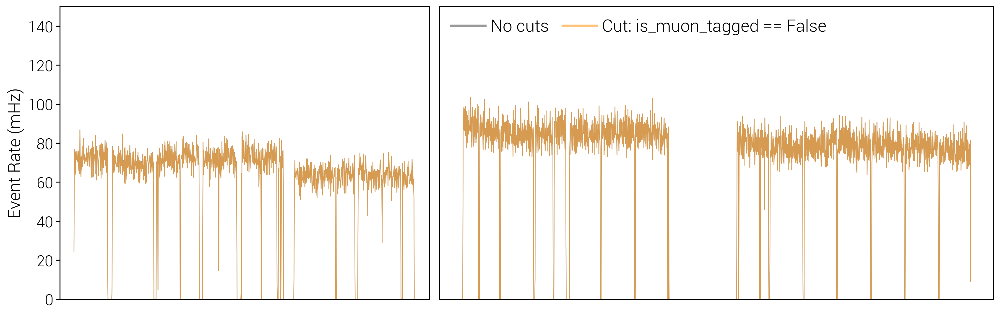

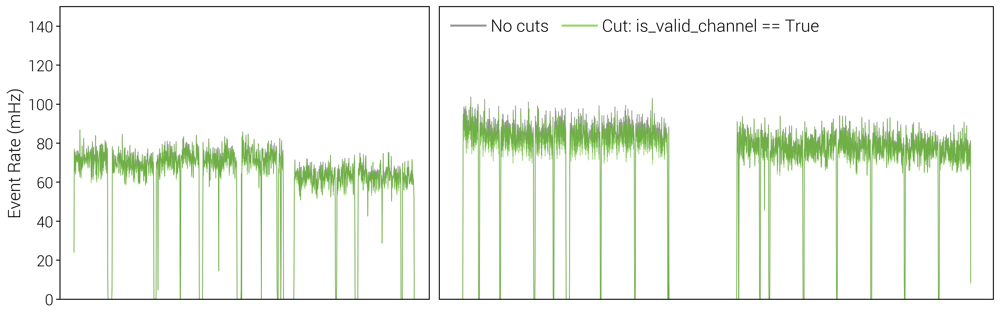

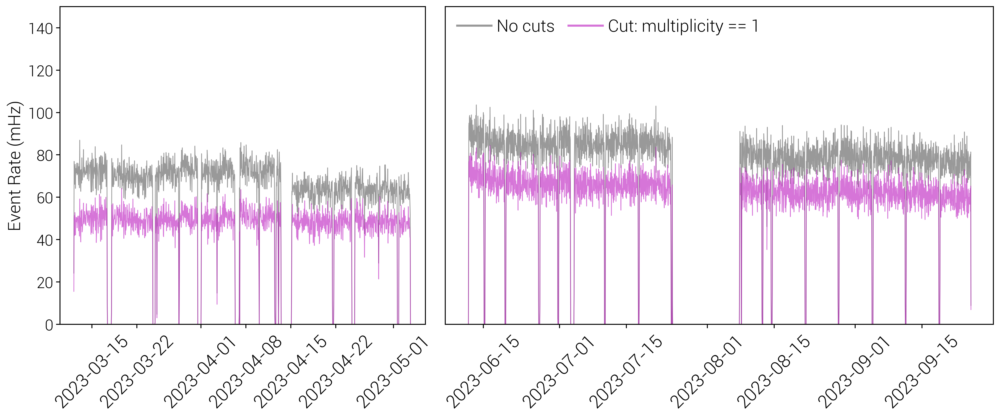

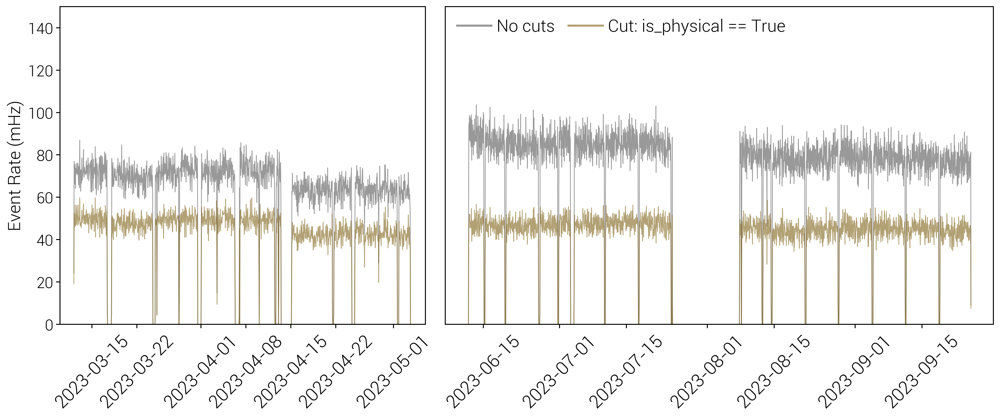

--------------------------PPC----------------------------


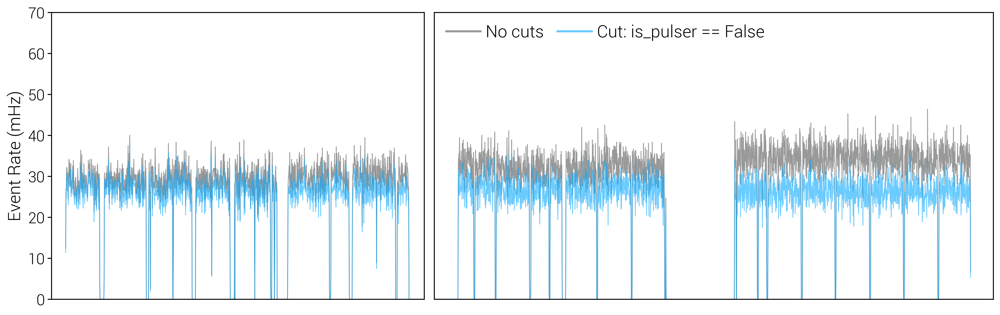

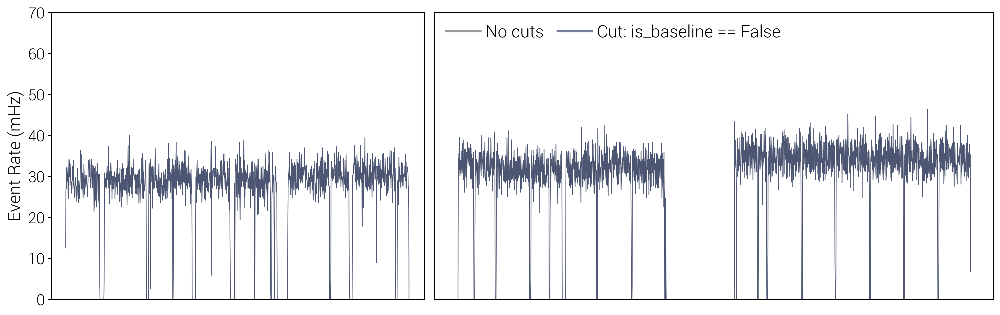

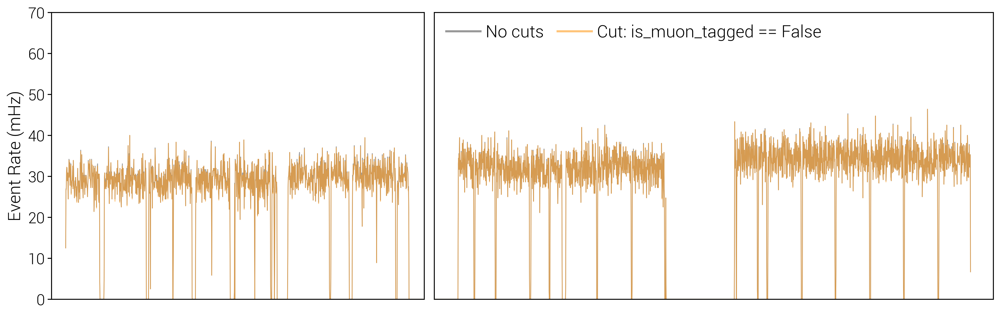

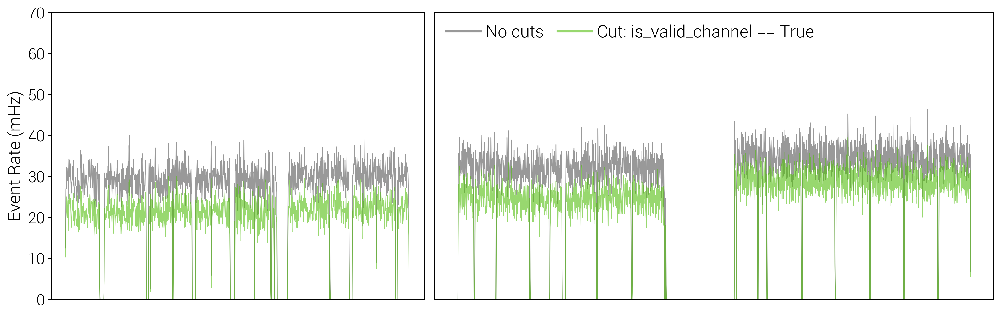

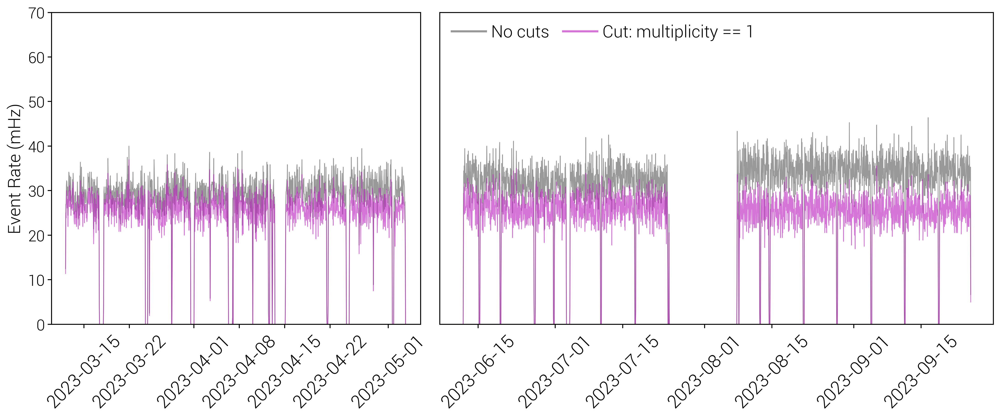

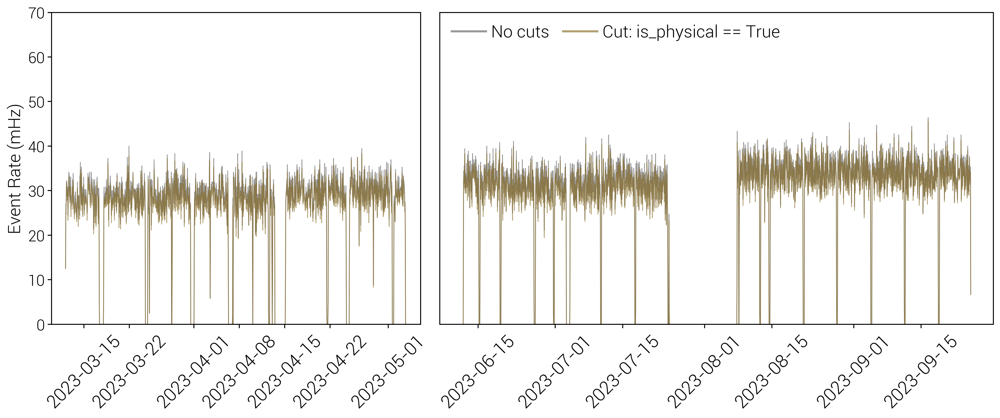

In [31]:
yranges = [(0, 350), (0, 100), (0, 150), (0, 70)]
for i, (d_type, yr) in enumerate(zip(nice_det_name_dict.keys(), yranges)):
    det_lab         = nice_det_name_dict[d_type]
    print(f'--------------------------{det_lab}----------------------------')
    data_det        = data[data.det_type==d_type]
    data_det_series = resample_df(data_det)    

    for i, ((cut, val), col) in enumerate(zip(all_cuts, legend_colors[1:])):
        df_test        = data_det[data_det[cut]==val]
        df_test_series = resample_df(df_test)
    
        if i >= len(all_cuts)-2:
            fig, axs = lps.subplots(1, 2, figsize=(14.5, 6), gridspec_kw={'width_ratios': [1, 1.5]})
        else:
            fig, axs = lps.subplots(1, 2, figsize=(14.5, 4.5), gridspec_kw={'width_ratios': [1, 1.5]})
            
        for ax in axs:
            ax.plot(data_det_series   .index, data_det_series,     linewidth=0.8, alpha=0.8, color='grey', label='No cuts')
            ax.plot(df_test_series.index, df_test_series,  linewidth=0.8, alpha=0.6, color=lps.colors[col], label=f'Cut: {str(cut)} == {str(val)}')
            ax.tick_params(axis='x', labelsize=19, rotation=45)
            ax.tick_params(axis='y', labelsize=16)
            ax.set_ylim(yr)
            if i < len(all_cuts)-2:
                ax.set_xticks([])
    
        #axs[0].text(pd.to_datetime('2023-03-25'), 915, f'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
        #axs[0].text(pd.to_datetime('2023-04-21'), 915, f'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
        #
        #axs[1].text(pd.to_datetime('2023-06-28'), 915, f'Period 6', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
        #axs[1].text(pd.to_datetime('2023-08-28'), 915, f'Period 7', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6), fontsize=16)
        
        #axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
        axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
        axs[1].set_xlim(pd.to_datetime('2023-06-07'), pd.to_datetime('2023-09-30'))
        axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
        axs[1].set_yticks([])
        leg = axs[1].legend(ncol=2, fontsize=18, loc='upper left')
        for line in leg.get_lines():
            line.set_linewidth(2.2)
        plt.tight_layout()
        plt.show()

## Energy

In [32]:
energy_ranges = [(200,600), (900,1300), (1400,1600), (1900,2500), (2550,2700), (4500,5500)]
energy_colors = ['violet', 'red', 'legend_blue', 'teal', 'legend_darkblue', 'yellow']

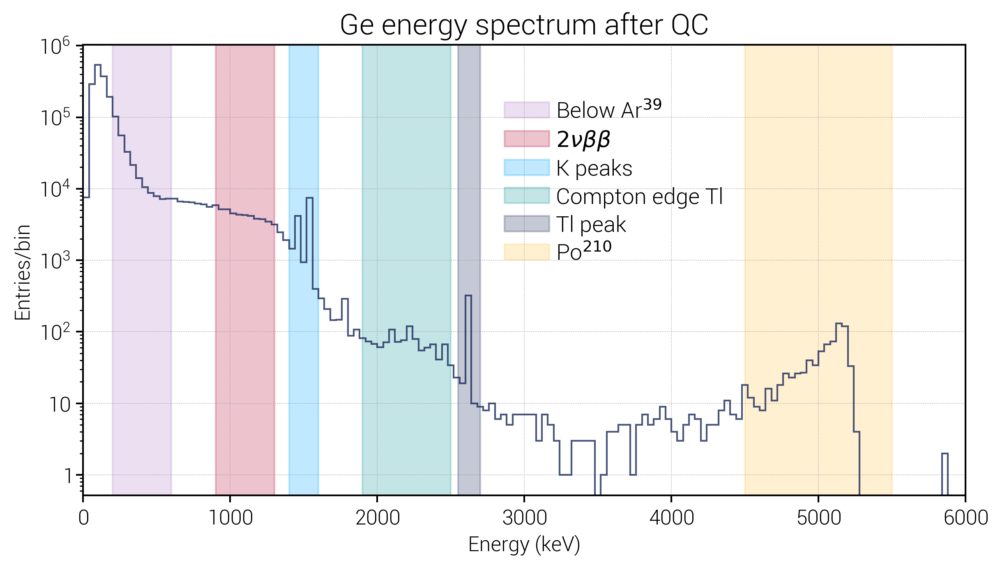

In [33]:
fig, ax = lps.subplots()
data_filt.energy.hist(bins=150, range=(0, 6000), log=True, alpha=0.8, histtype='step', color=lps.colors['legend_darkblue'])
plt.axvspan(energy_ranges[0][0], energy_ranges[0][1], label=r'Below Ar$^{39}$',  color=lps.colors[energy_colors[0]], alpha=0.25)
plt.axvspan(energy_ranges[1][0], energy_ranges[1][1], label=r'$2\nu\beta\beta$', color=lps.colors[energy_colors[1]], alpha=0.25)
plt.axvspan(energy_ranges[2][0], energy_ranges[2][1], label='K peaks'          , color=lps.colors[energy_colors[2]], alpha=0.25)
plt.axvspan(energy_ranges[3][0], energy_ranges[3][1], label='Compton edge Tl'  , color=lps.colors[energy_colors[3]], alpha=0.25)
plt.axvspan(energy_ranges[4][0], energy_ranges[4][1], label='Tl peak'          , color=lps.colors[energy_colors[4]], alpha=0.25)
plt.axvspan(energy_ranges[5][0], energy_ranges[5][1], label=r'Po$^{210}$'      , color=lps.colors[energy_colors[5]], alpha=0.25)
plt.title('Ge energy spectrum after QC', fontsize=17)
plt.xlabel('Energy (keV)')
plt.ylabel('Entries/bin')
plt.legend(bbox_to_anchor=(0.46, 0.91), fontsize=13)
plt.xlim(0, 6000)
plt.show()

In [34]:
def evt_arte_energy_cuts(df, e1, e2, timest='1H'):
    df_e = df[(df.energy>e1)&(df.energy<=e2)]
    df_e_series = resample_df(df_e, timest)
    return df_e_series

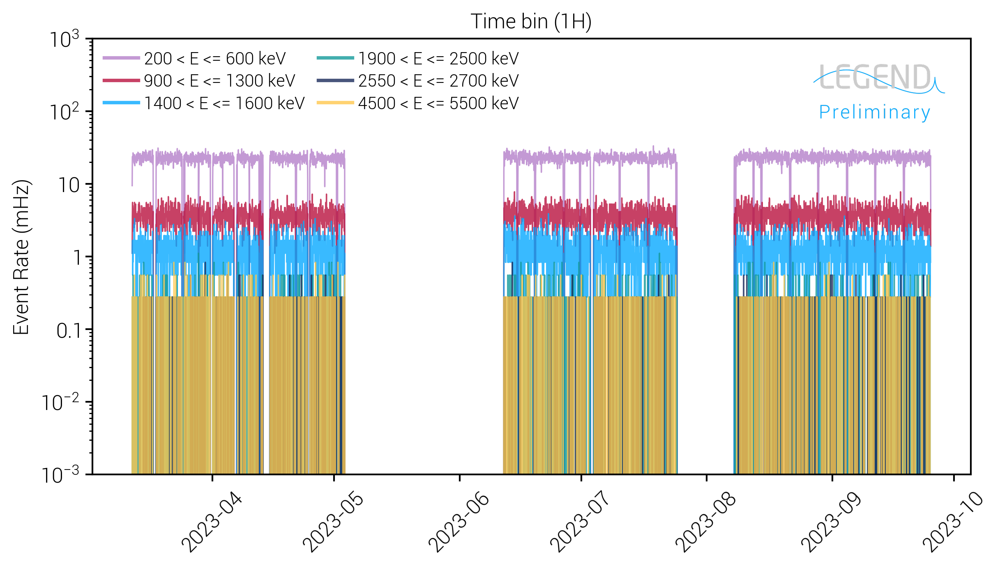

In [35]:
timestamp = '1H'

fig, ax = lps.subplots()
for (e1, e2), col in zip(energy_ranges, energy_colors):
    data_filt_e_sr = evt_arte_energy_cuts(data_filt, e1, e2, timest=timestamp)
    ax.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_title(f'Time bin ({timestamp})')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=2, fontsize=10, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(10**(-3), 10**3)
#plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
plt.yscale('log')
plt.show()

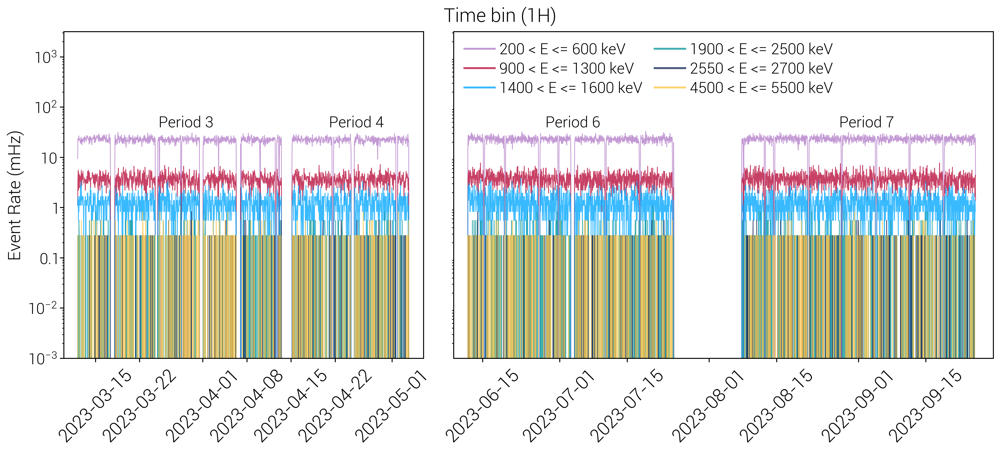

In [36]:
timestamp = '1H'
fig, axs = lps.subplots(1, 2, figsize=(14.5, 6.5), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    
    for (e1, e2), col in zip(energy_ranges, energy_colors):
        data_filt_e_sr = evt_arte_energy_cuts(data_filt, e1, e2, timest=timestamp)
        ax.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')

    ax.tick_params(axis='x', labelsize=19, rotation=45)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_ylim(10**(-3), 10**3.5)
    ax.set_yscale('log')
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 40, f'Period 3', fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 40, f'Period 4', fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 40, f'Period 6', fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 40, f'Period 7', fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-09'), pd.to_datetime('2023-09-29'))
axs[1].set_yticks([])

leg = axs[1].legend(ncol=2, fontsize=16, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
    
fig.suptitle(f'Time bin ({timestamp})', fontsize=20)

plt.show()

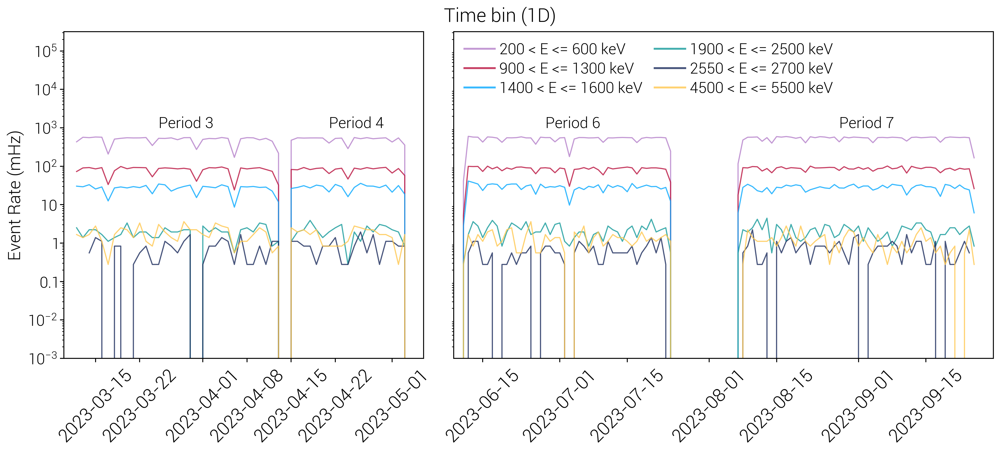

In [37]:
timestamp = '1D'
fig, axs = lps.subplots(1, 2, figsize=(14.5, 6.5), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    
    for (e1, e2), col in zip(energy_ranges, energy_colors):
        data_filt_e_sr = evt_arte_energy_cuts(data_filt, e1, e2, timest=timestamp)
        ax.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=1.2, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')

    ax.tick_params(axis='x', labelsize=19, rotation=45)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_ylim(10**(-3), 10**5.5)
    ax.set_yscale('log')
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 1000, f'Period 3', fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 1000, f'Period 4', fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 1000, f'Period 6', fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 1000, f'Period 7', fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-09'), pd.to_datetime('2023-09-29'))
axs[1].set_yticks([])

leg = axs[1].legend(ncol=2, fontsize=16, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
    
fig.suptitle(f'Time bin ({timestamp})', fontsize=20)

plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


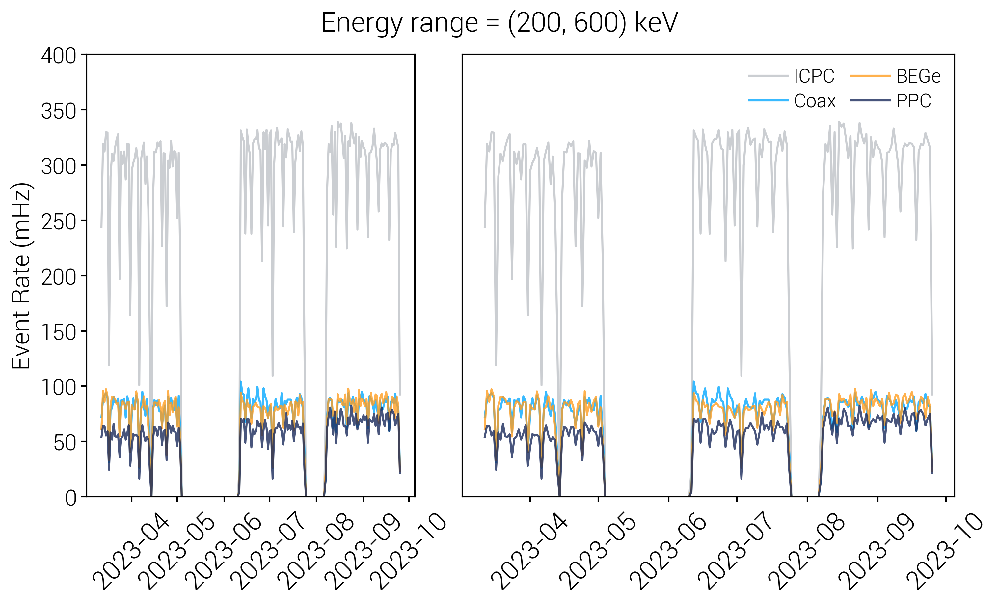

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


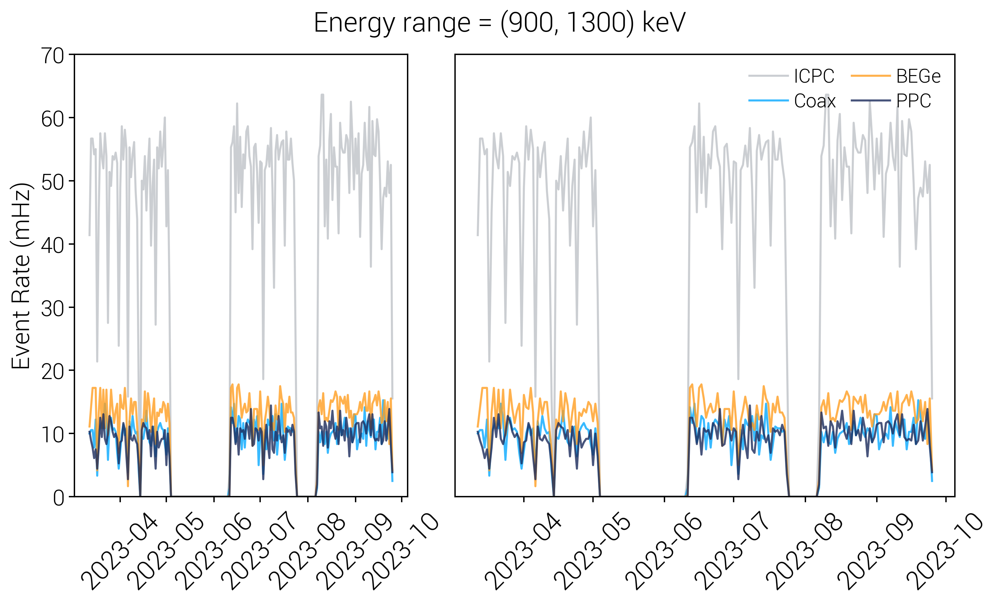

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


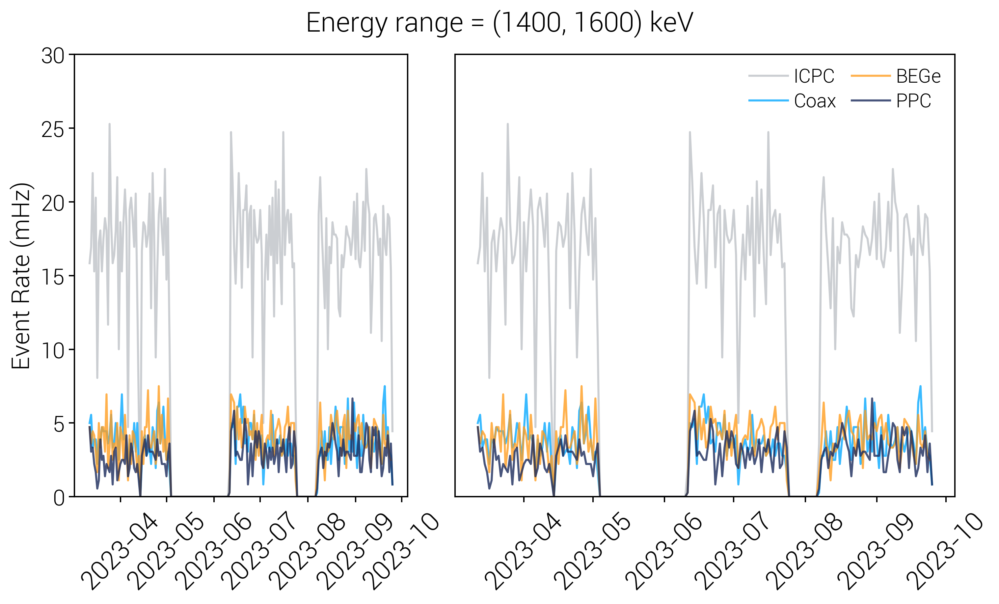

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


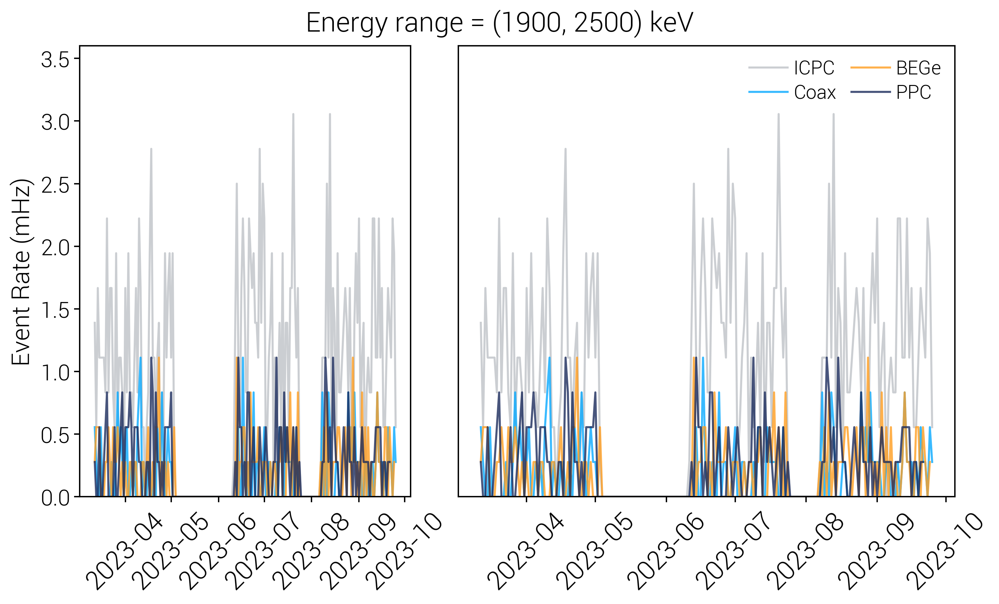

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


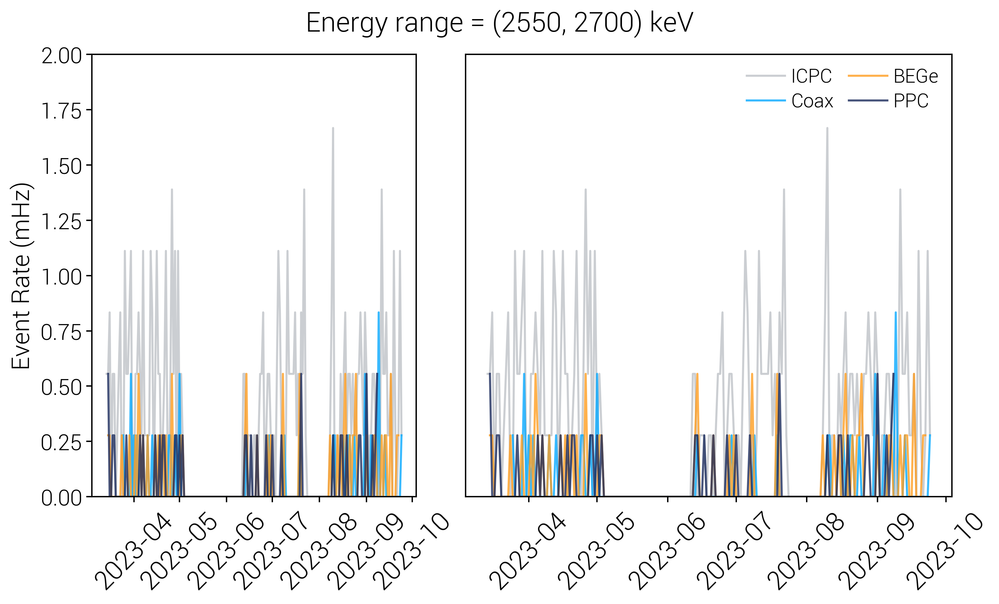

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


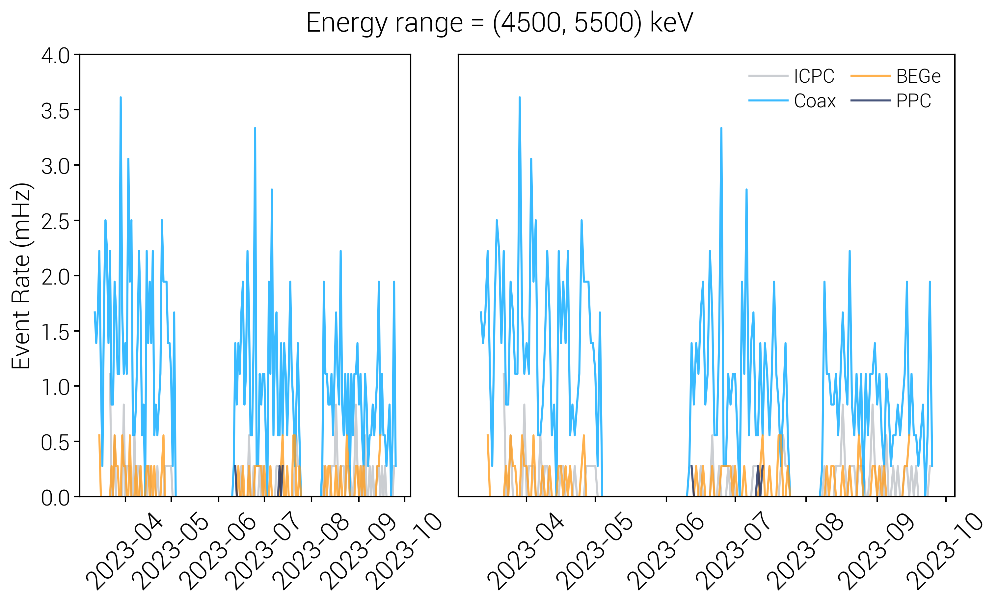

In [38]:
for i, ((e1, e2), yl) in enumerate(zip(energy_ranges, [(0, 400), (0, 70), (0, 30), (0, 3.6), (0, 2), (0, 4)])):
    #if i in [0, 1, 2]:
    #    continue
    fig, axs = lps.subplots(1, 2, figsize=(10, 6), gridspec_kw={'width_ratios': [1, 1.5]})
    for ax in axs:
        for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
            det_lab         = nice_det_name_dict[d_type]
            data_filt_det_e = data_filt[(data_filt.det_type==d_type) & (data_filt.energy>e1) & (data_filt.energy<=e2)]
            data_filt_det_e_s = resample_df(data_filt_det_e, timestamp='1D')
        
            ax.plot(data_filt_det_e_s.index, data_filt_det_e_s, linewidth=1.5, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
        
            ax.tick_params(axis='x', labelsize=19, rotation=45)
            ax.tick_params(axis='y', labelsize=16)
            ax.set_ylim(yl)

        axs[1].set_yticks([])
        axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
        axs[1].legend(fontsize=14, loc='upper right', ncol=2)

    fig.suptitle(f'Energy range = ({e1}, {e2}) keV', fontsize=20)
    plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


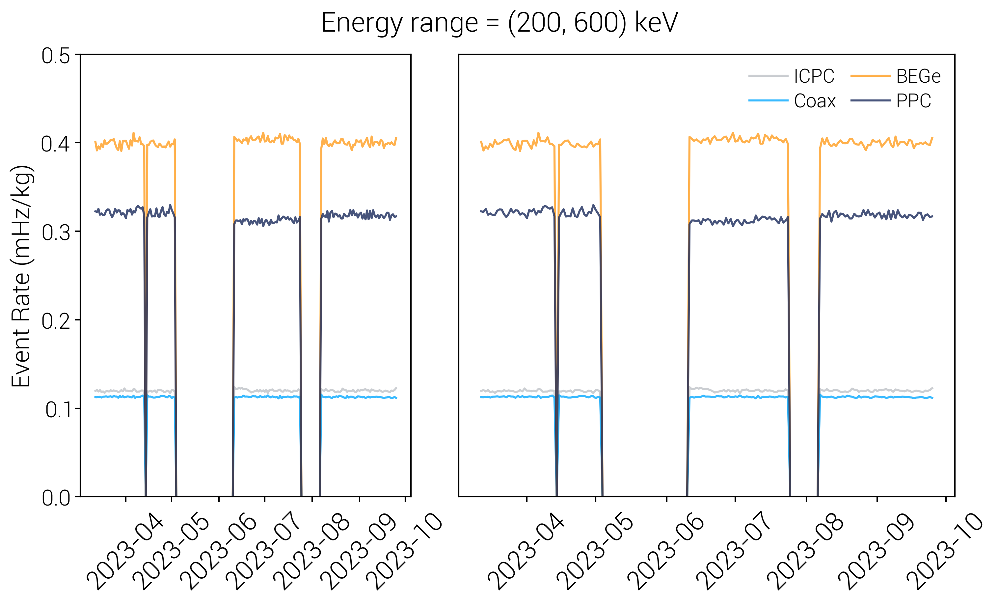

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


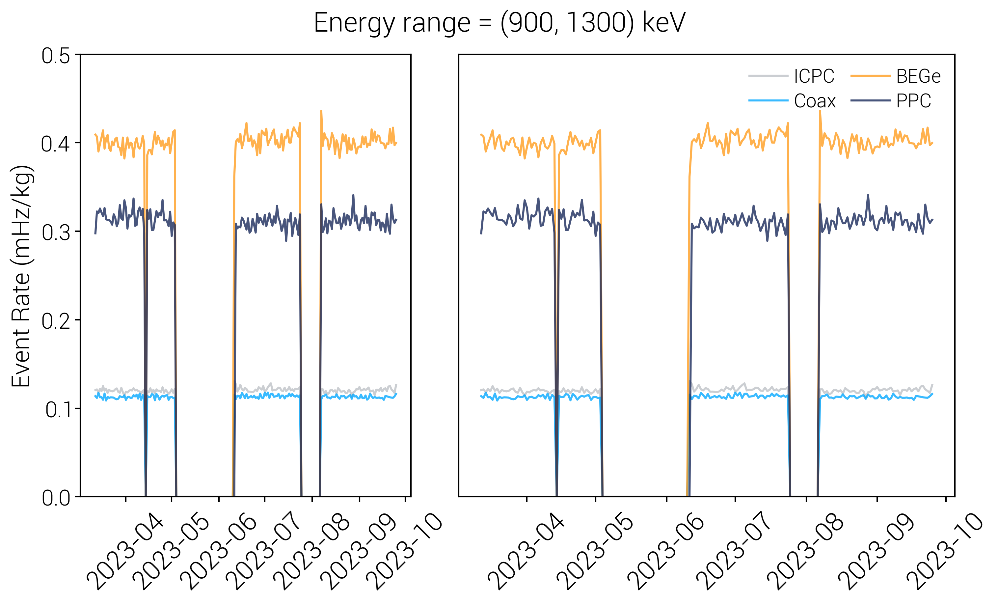

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


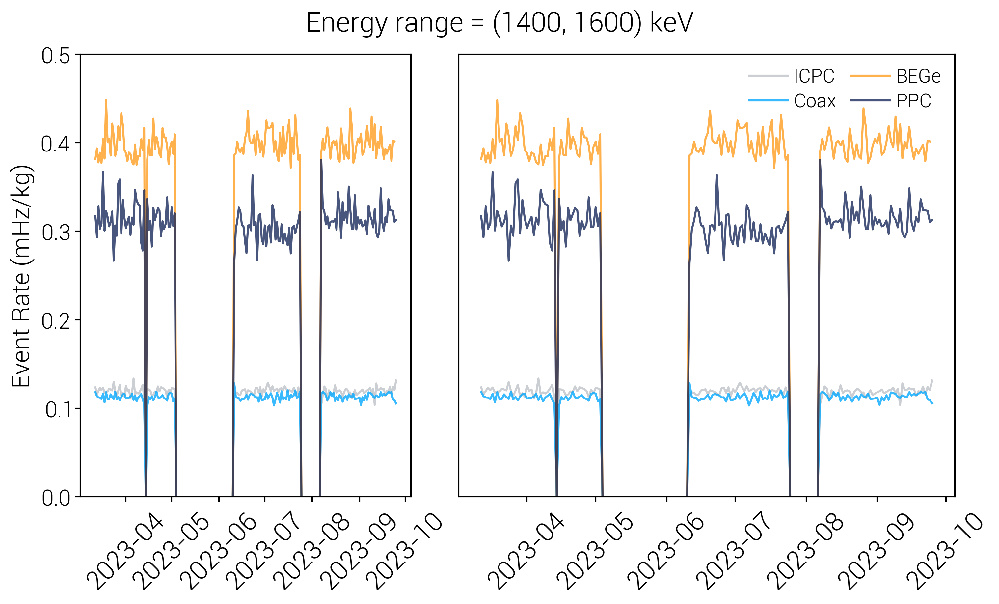

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


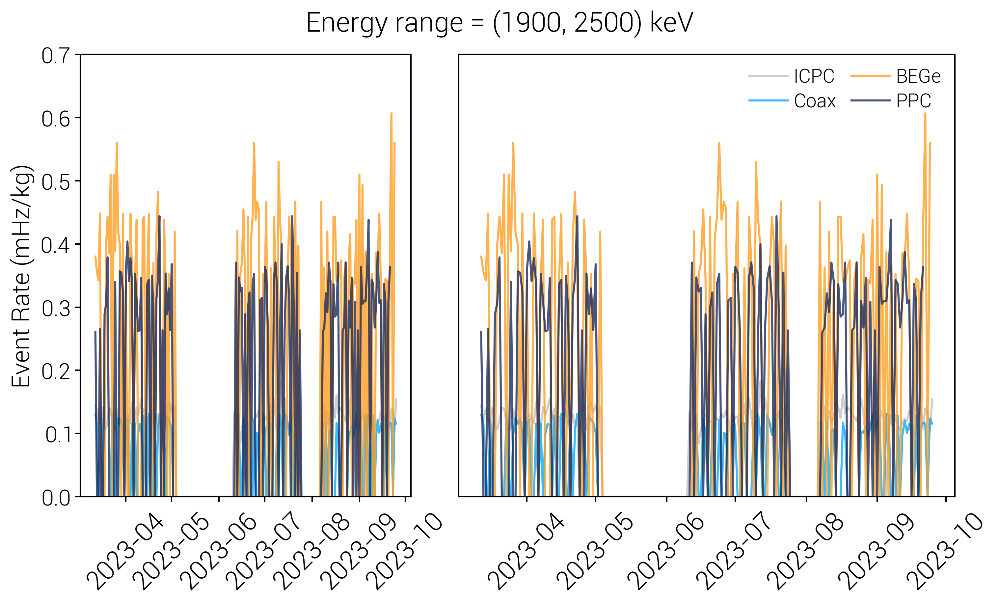

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


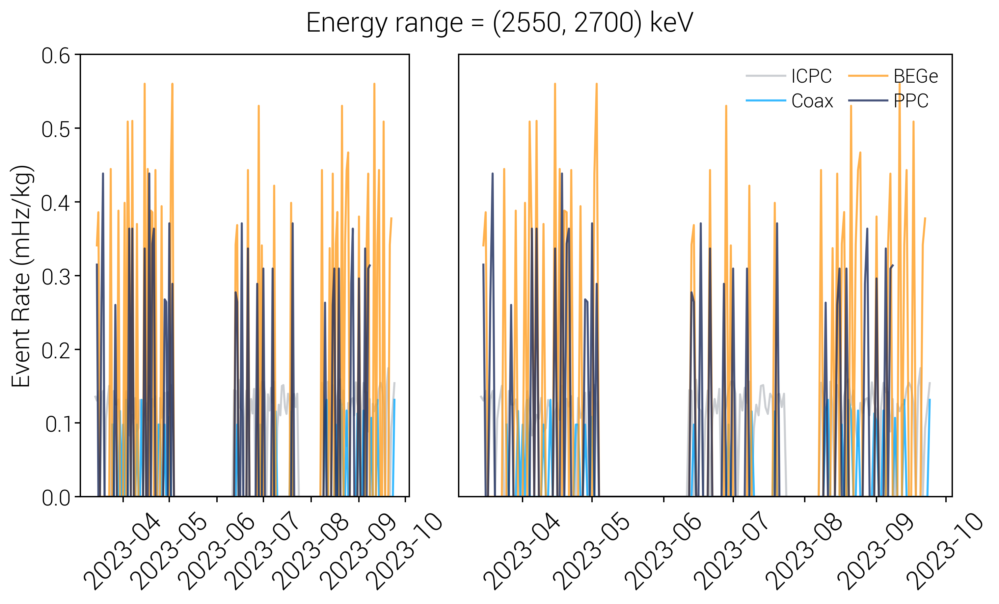

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


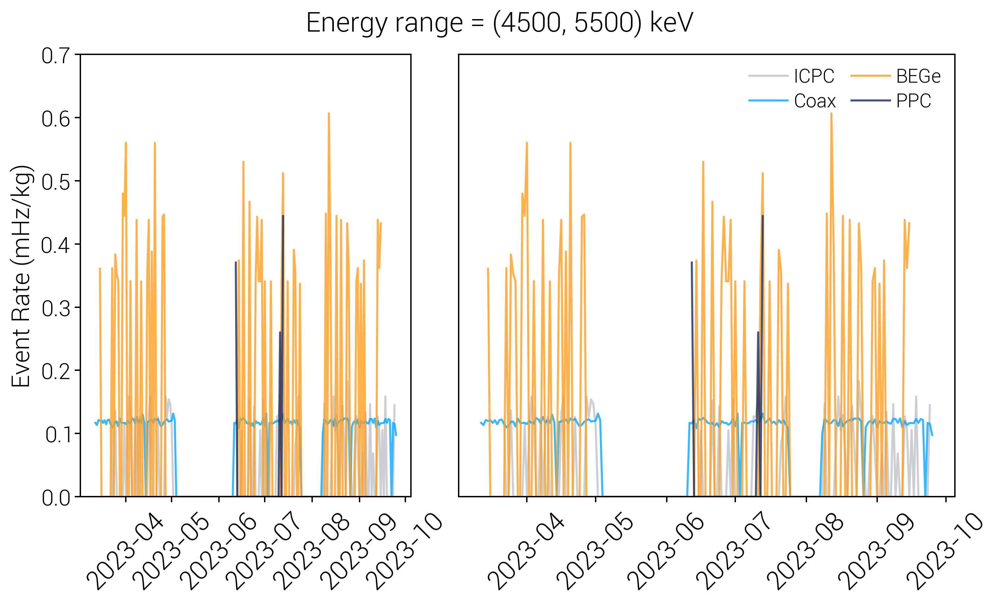

In [39]:
for i, ((e1, e2), yl) in enumerate(zip(energy_ranges, [(0, 0.5), (0, 0.5), (0, 0.5), (0, 0.7), (0, 0.6), (0, 0.7)])):
    #if i in [0, 1, 2]:
    #    continue
    fig, axs = lps.subplots(1, 2, figsize=(10, 6), gridspec_kw={'width_ratios': [1, 1.5]})
    for ax in axs:
        for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
            det_lab         = nice_det_name_dict[d_type]
            data_filt_det_e = data_filt[(data_filt.det_type==d_type) & (data_filt.energy>e1) & (data_filt.energy<=e2)]
            data_filt_det_e_s = resample_df_norm_mass(data_filt_det_e, timestamp='1D')

            ax.plot(data_filt_det_e_s.index, data_filt_det_e_s, linewidth=1.5, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
        
            ax.tick_params(axis='x', labelsize=19, rotation=45)
            ax.tick_params(axis='y', labelsize=16)
            ax.set_ylim(yl)

        axs[1].set_yticks([])
        axs[0].set_ylabel('Event Rate (mHz/kg)', fontsize=18)
        axs[1].legend(fontsize=14, loc='upper right', ncol=2)

    fig.suptitle(f'Energy range = ({e1}, {e2}) keV', fontsize=20)
    plt.show()

### Silver and golden datasets

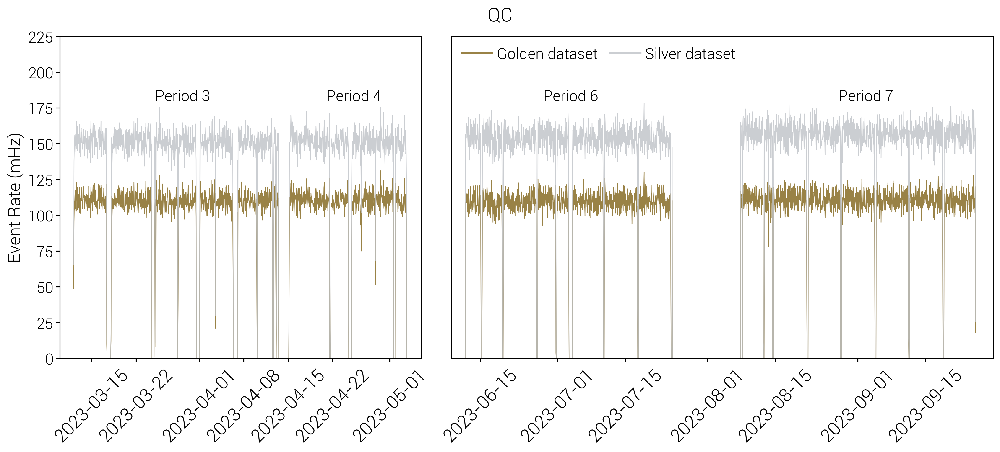

In [40]:
fig, axs = lps.subplots(1, 2, figsize=(14.5, 6.5), gridspec_kw={'width_ratios': [1, 1.5]})
data_golden = data_filt[data_filt.is_usable_aoe == True]
data_silver = data_filt
data_golden_series = resample_df(data_golden)
data_silver_series = resample_df(data_silver)
for ax in axs:
    ax.plot(data_golden_series.index, data_golden_series, linewidth=0.8, color=lps.colors['legend_gold'], alpha=0.8, label=f'Golden dataset')
    ax.plot(data_silver_series.index, data_silver_series, linewidth=0.8, color=lps.colors['silver'],      alpha=0.8, label=f'Silver dataset')

    ax.tick_params(axis='x', labelsize=19, rotation=45)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_ylim(0, 225)
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 180, f'Period 3', fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 180, f'Period 4', fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 180, f'Period 6', fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 180, f'Period 7', fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-09'), pd.to_datetime('2023-09-29'))
axs[1].set_yticks([])

leg = axs[1].legend(ncol=4, fontsize=16, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
    
fig.suptitle('QC', fontsize=20)

plt.show()

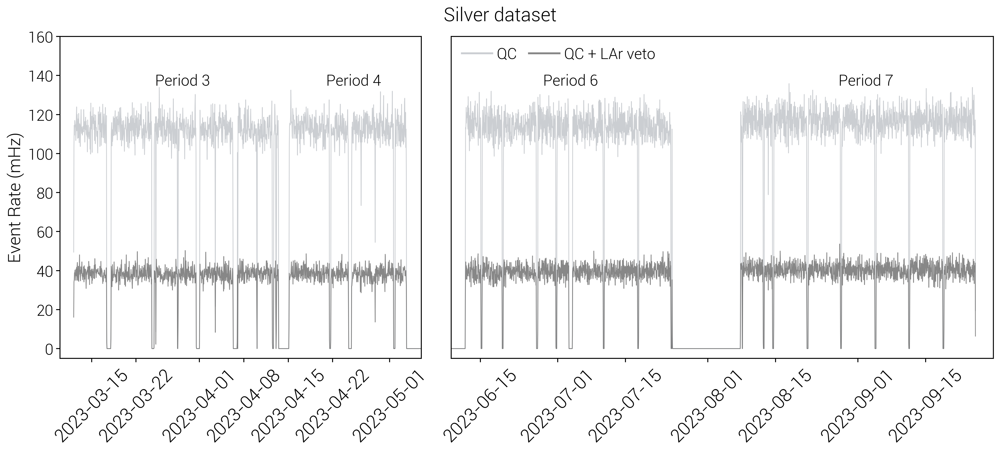

In [41]:
timestamp = '1H'
colors  = [lps.colors['silver'], 'dimgrey']
labs    = ['QC', 'QC + LAr veto']
vals    = [True, False]

fig, axs = lps.subplots(1, 2, figsize=(14.5, 6.5), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    for val, col, lab in zip(vals, colors, labs):
        data_cut_silver        = data_filt[data_filt.is_lar_rejected==val]
        data_cut_silver_series = resample_df(data_cut_silver, timestamp)
        ax.plot(data_cut_silver_series.index, data_cut_silver_series, linewidth=0.8, color=col, alpha=0.8, label=f'{lab}')
    
        ax.tick_params(axis='x', labelsize=19, rotation=45)
        ax.tick_params(axis='y', labelsize=16)
        ax.set_ylim(-5, 160)
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 135, f'Period 3', fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 135, f'Period 4', fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 135, f'Period 6', fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 135, f'Period 7', fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-09'), pd.to_datetime('2023-09-29'))
axs[1].set_yticks([])

leg = axs[1].legend(ncol=4, fontsize=16, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
    
fig.suptitle('Silver dataset', fontsize=20)
    
plt.show()

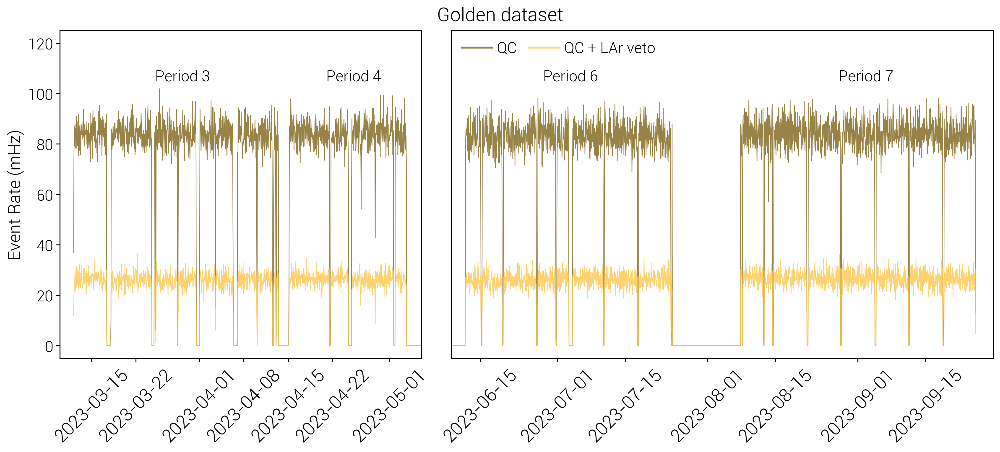

In [42]:
timestamp = '1H'
colors  = [lps.colors['legend_gold'], lps.colors['yellow']]
labs    = ['QC', 'QC + LAr veto']
vals    = [True, False]

fig, axs = lps.subplots(1, 2, figsize=(14.5, 6.5), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    for val, col, lab in zip(vals, colors, labs):
        data_cut_gold          = data_filt[(data_filt.is_usable_aoe==True)&(data_filt.is_lar_rejected==val)]
        data_cut_gold_series   = resample_df(data_cut_gold, timestamp)
        ax.plot(data_cut_gold_series.index, data_cut_gold_series, linewidth=0.8, color=col, alpha=0.8, label=f'{lab}')
    
        ax.tick_params(axis='x', labelsize=19, rotation=45)
        ax.tick_params(axis='y', labelsize=16)
        ax.set_ylim(-5, 125)
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 105, f'Period 3', fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 105, f'Period 4', fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 105, f'Period 6', fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 105, f'Period 7', fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-09'), pd.to_datetime('2023-09-29'))
axs[1].set_yticks([])

leg = axs[1].legend(ncol=4, fontsize=16, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
    
fig.suptitle('Golden dataset', fontsize=20)
    
plt.show()

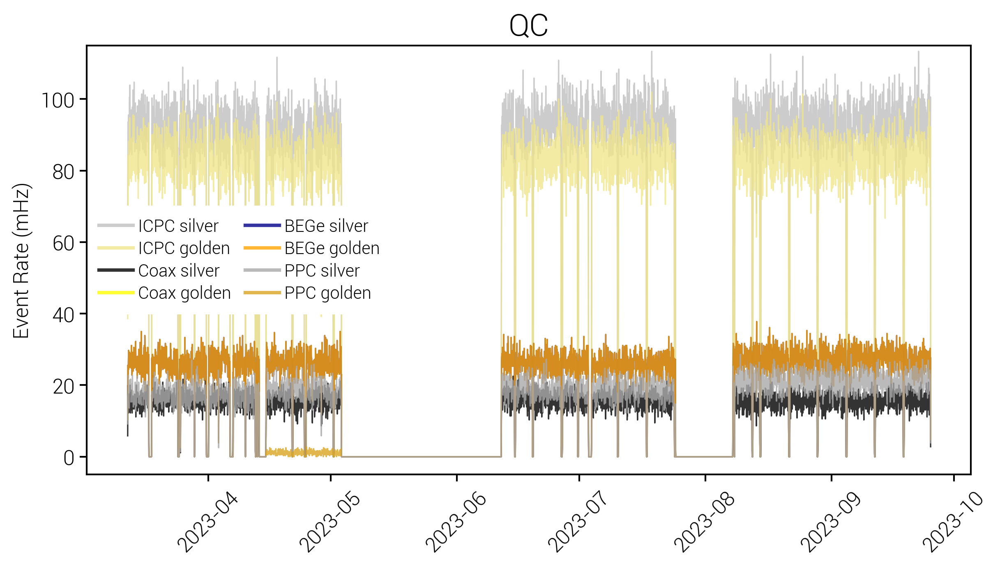

In [43]:
from matplotlib.patches import Rectangle

fig, ax = lps.subplots()
for d_type, col1, col2 in zip(nice_det_name_dict.keys(), ['khaki', 'yellow', 'orange', 'goldenrod'], ['silver', 'k', 'darkblue', 'darkgrey']):
    det_lab         = nice_det_name_dict[d_type]
    data_filt_det   = data_filt[data_filt.det_type==d_type]
    
    data_golden = data_filt_det[data_filt_det.is_usable_aoe == True]
    data_silver = data_filt_det
    data_golden_series = resample_df(data_golden, timestamp='1H')
    data_silver_series = resample_df(data_silver, timestamp='1H')
    #ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
    ax.plot(data_silver_series.index, data_silver_series, linewidth=0.8, color=col2, alpha=0.8, label=f'{det_lab} silver', zorder=1)
    ax.plot(data_golden_series.index, data_golden_series, linewidth=0.8, color=col1, alpha=0.8, label=f'{det_lab} golden', zorder=1)
    ax.set_title(f'QC', fontsize=18)
    ax.set_ylabel('Event Rate (mHz)')

start_date = pd.to_datetime('2023-03-12')
end_date   = pd.to_datetime('2023-05-30')
num_start  = mdates.date2num(start_date)
num_end    = mdates.date2num(end_date)
square1 = Rectangle((num_start, 40), num_end - num_start, 30, edgecolor='white', facecolor='white', zorder=2)
plt.gca().add_patch(square1)
leg = ax.legend(ncol=2, fontsize=10, loc='center left', shadow=False)
for line in leg.get_lines():
    line.set_linewidth(2)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_ylim(-5, 115)
plt.show()

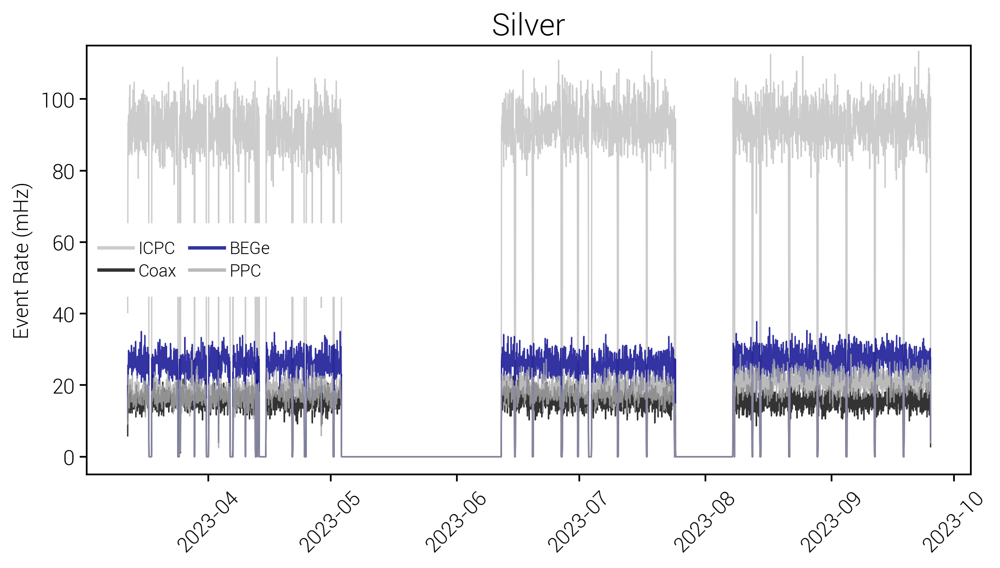

In [44]:
fig, ax = lps.subplots()
for d_type, col1, col2 in zip(nice_det_name_dict.keys(), ['khaki', 'yellow', 'orange', 'goldenrod'], ['silver', 'k', 'darkblue', 'darkgrey']):
    det_lab         = nice_det_name_dict[d_type]
    data_filt_det   = data_filt[data_filt.det_type==d_type]
    
    data_golden = data_filt_det[data_filt_det.is_usable_aoe == True]
    data_silver = data_filt_det
    data_golden_series = resample_df(data_golden, timestamp='1H')
    data_silver_series = resample_df(data_silver, timestamp='1H')
    ax.plot(data_silver_series.index, data_silver_series, linewidth=0.8, color=col2, alpha=0.8, label=f'{det_lab}', zorder=1)
    ax.set_title(f'Silver', fontsize=18)
    ax.set_ylabel('Event Rate (mHz)')

start_date = pd.to_datetime('2023-03-12')
end_date   = pd.to_datetime('2023-05-30')
num_start  = mdates.date2num(start_date)
num_end    = mdates.date2num(end_date)
square1 = Rectangle((num_start, 45), num_end - num_start, 20, edgecolor='white', facecolor='white', zorder=2)
plt.gca().add_patch(square1)
leg = ax.legend(ncol=2, fontsize=10, loc='center left', shadow=False)
for line in leg.get_lines():
    line.set_linewidth(2)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_ylim(-5, 115)
plt.show()

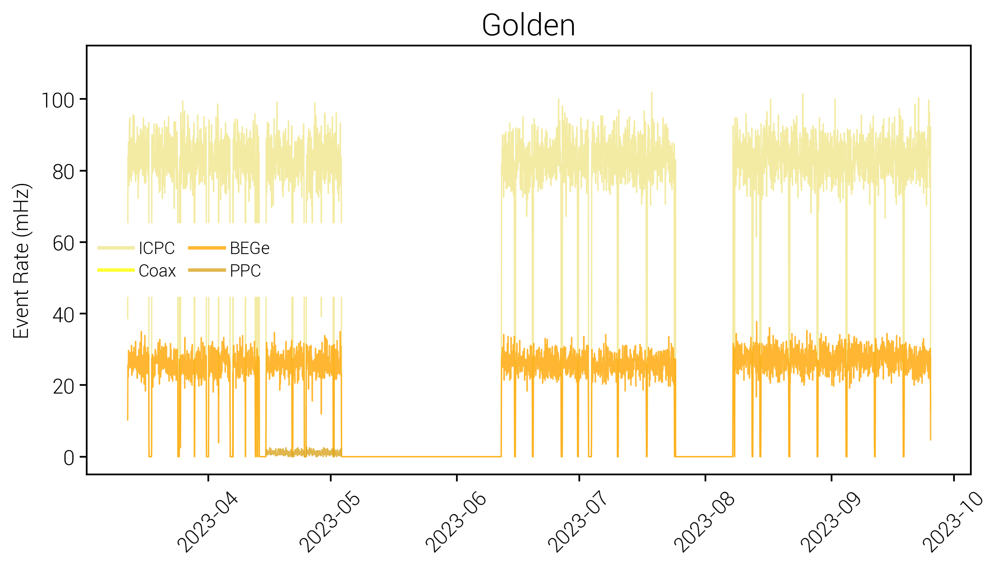

In [45]:
fig, ax = lps.subplots()
for d_type, col1 in zip(nice_det_name_dict.keys(), ['khaki', 'yellow', 'orange', 'goldenrod']):
    det_lab         = nice_det_name_dict[d_type]
    data_filt_det   = data_filt[data_filt.det_type==d_type]
    
    data_golden = data_filt_det[data_filt_det.is_usable_aoe == True]
    data_golden_series = resample_df(data_golden, timestamp='1H')
    ax.plot(data_golden_series.index, data_golden_series, linewidth=0.8, color=col1, alpha=0.8, label=f'{det_lab}', zorder=1)
    ax.set_title(f'Golden', fontsize=18)
    ax.set_ylabel('Event Rate (mHz)')

start_date = pd.to_datetime('2023-03-12')
end_date   = pd.to_datetime('2023-05-30')
num_start  = mdates.date2num(start_date)
num_end    = mdates.date2num(end_date)
square1 = Rectangle((num_start, 45), num_end - num_start, 20, edgecolor='white', facecolor='white', zorder=2)
plt.gca().add_patch(square1)
leg = ax.legend(ncol=2, fontsize=10, loc='center left', shadow=False)
for line in leg.get_lines():
    line.set_linewidth(2)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_ylim(-5, 115)
plt.show()

### After LAr veto cut

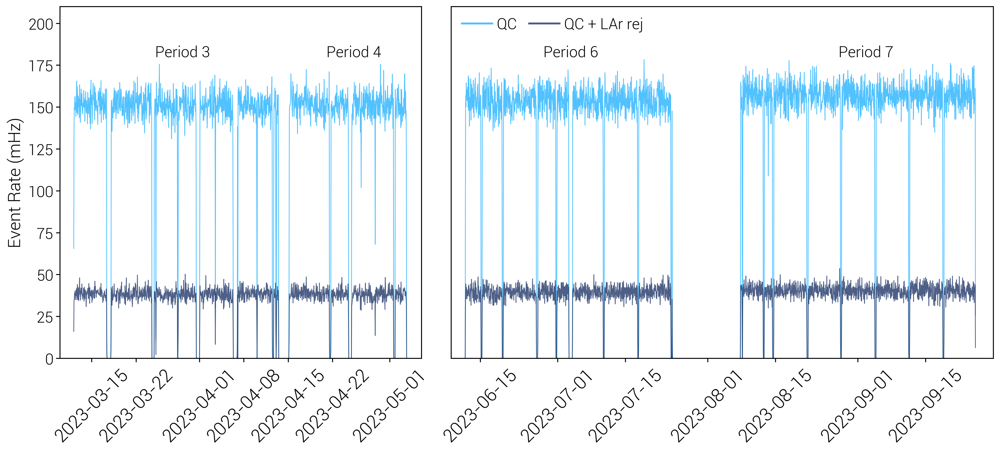

In [46]:
data_filt_lar_rej        = data_filt[data_filt.is_lar_rejected==False]
data_filt_lar_rej_series = resample_df(data_filt_lar_rej)
fig, axs = lps.subplots(1, 2, figsize=(14.5, 6.5), gridspec_kw={'width_ratios': [1, 1.5]})
for ax in axs:
    ax.plot(data_filt_series        .index, data_filt_series        , linewidth=0.8, color=lps.colors['legend_blue'], alpha=0.7, label='QC')
    ax.plot(data_filt_lar_rej_series.index, data_filt_lar_rej_series, linewidth=0.8, color=lps.colors['darkblue'], alpha=0.8, label='QC + LAr rej')

    ax.tick_params(axis='x', labelsize=19, rotation=45)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_ylim(0, 210)
        
        
axs[0].text(pd.to_datetime('2023-03-25'), 180, f'Period 3', fontsize=16)
axs[0].text(pd.to_datetime('2023-04-21'), 180, f'Period 4', fontsize=16)

axs[1].text(pd.to_datetime('2023-06-28'), 180, f'Period 6', fontsize=16)
axs[1].text(pd.to_datetime('2023-08-28'), 180, f'Period 7', fontsize=16)

axs[0].set_ylabel('Event Rate (mHz)', fontsize=18)
axs[0].set_xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-06'))
axs[1].set_xlim(pd.to_datetime('2023-06-09'), pd.to_datetime('2023-09-29'))
axs[1].set_yticks([])

leg = axs[1].legend(ncol=4, fontsize=16, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
    
plt.show()

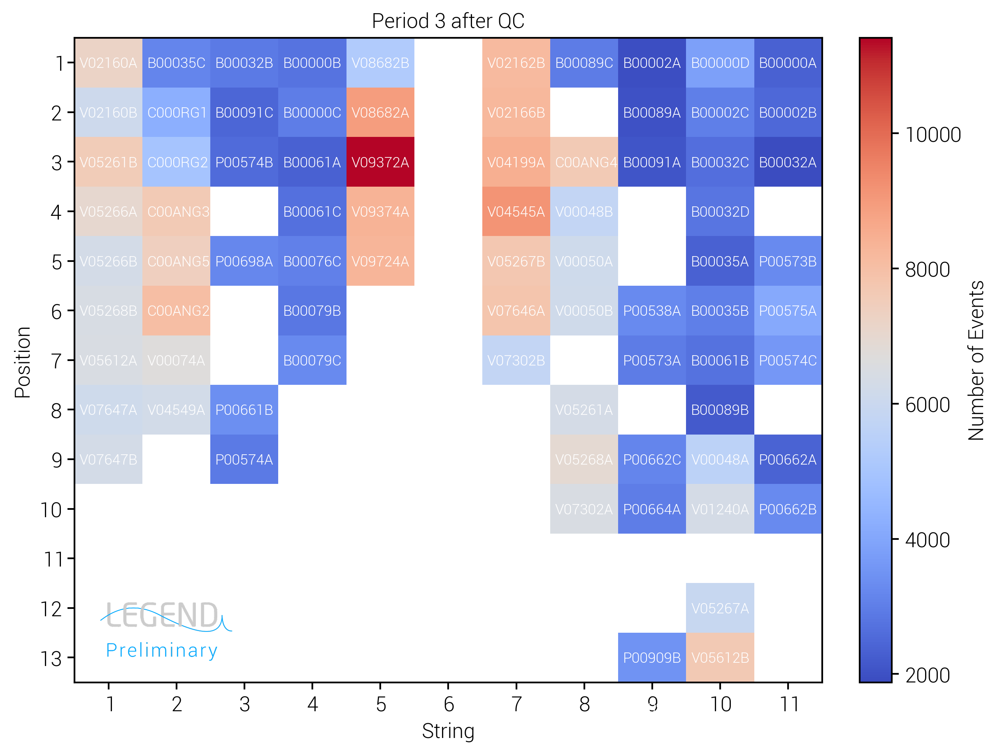

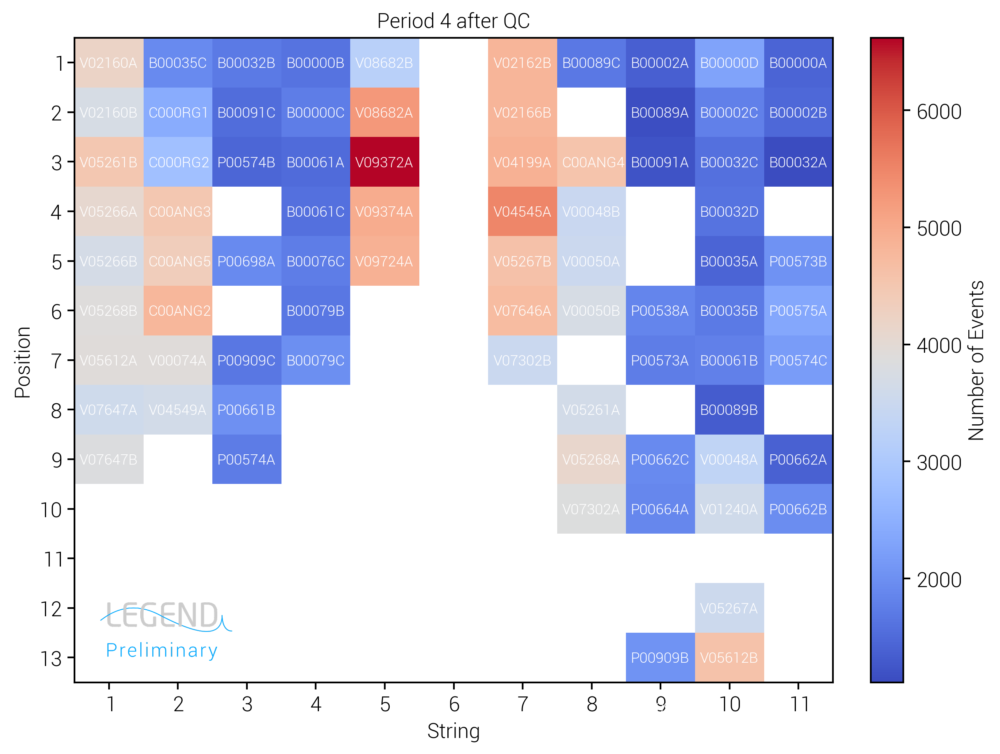

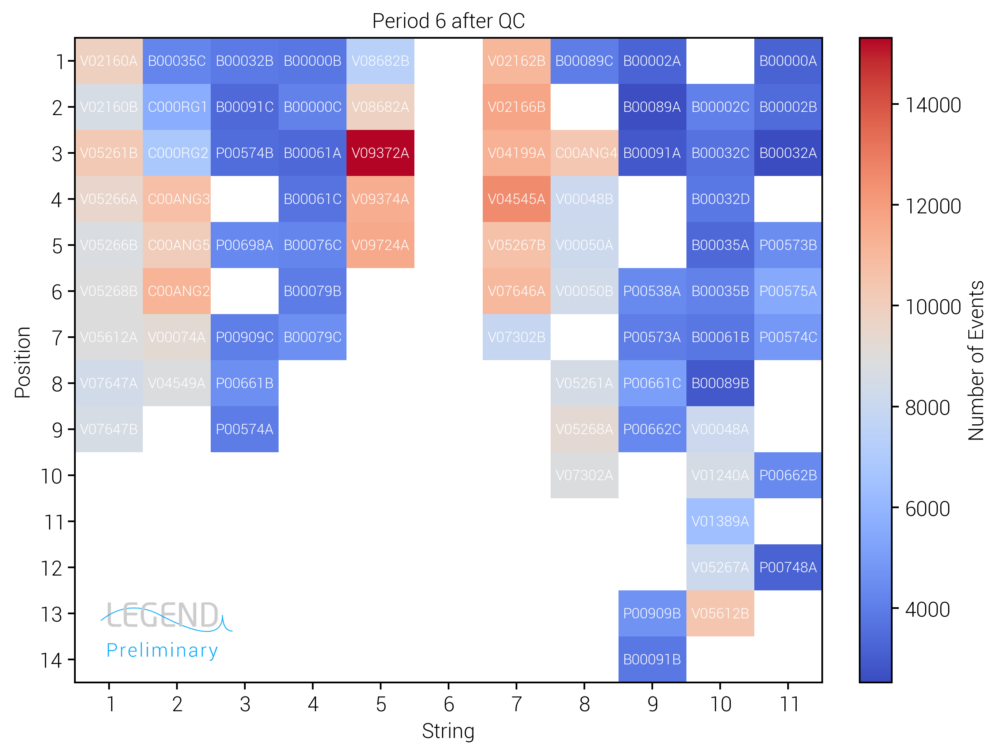

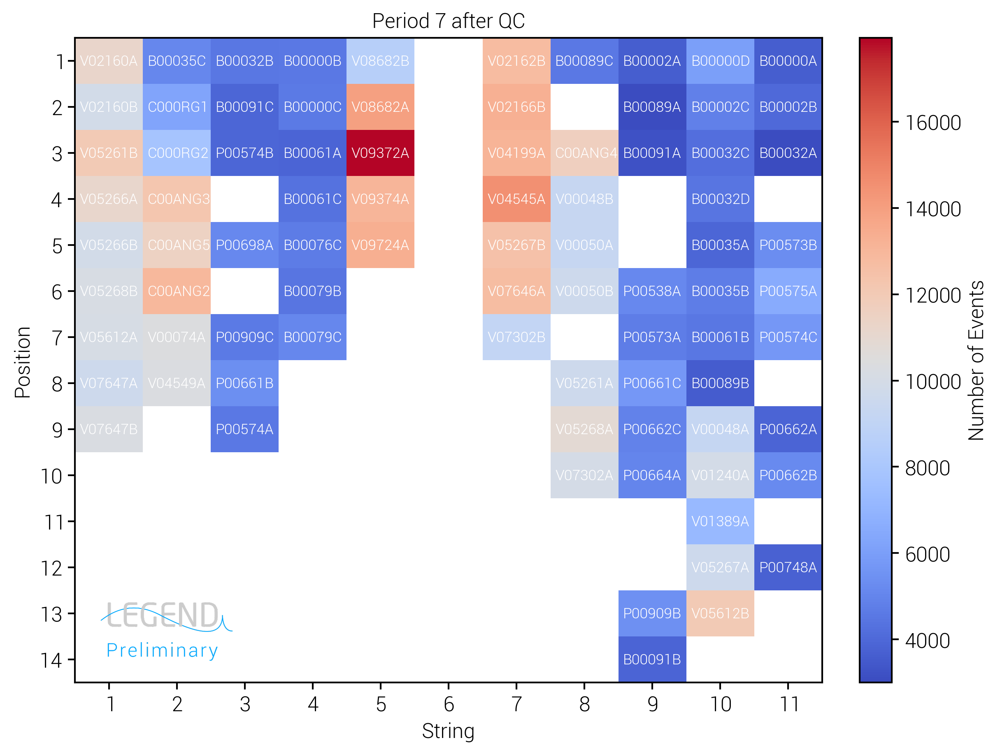

In [47]:
for data_sampl, title in zip([data_p03_filt, data_p04_filt, data_p06_filt, data_p07_filt],
                             ['Period 3', 'Period 4', 'Period 6', 'Period 7']):
    fig, ax = lps.subplots(figsize=(8, 6))
    bin_width = 1
    x_bins = np.arange(min(data_sampl.string)   - bin_width / 2, max(data_sampl.string)   + bin_width / 2 + bin_width, bin_width)
    y_bins = np.arange(min(data_sampl.position) - bin_width / 2, max(data_sampl.position) + bin_width / 2 + bin_width, bin_width)
    for v in channel_dict.values():
        plt.text(v[3]-0.43, v[4]+0.1, v[1], color='white', fontsize=8.5, weight='bold')
    plt.hist2d(data_sampl.string, data_sampl.position, bins=[x_bins, y_bins], cmap='coolwarm', cmin=1)
    ax.set_legend_logo(position='lower left', logo_type = 'preliminary')
    plt.colorbar(label='Number of Events')
    plt.xlabel('String')
    plt.ylabel('Position')
    plt.gca().invert_yaxis()
    plt.title(title+' after QC')
    plt.xticks(np.arange(min(data_sampl.string),   max(data_sampl.string)   + 1, bin_width))
    plt.yticks(np.arange(min(data_sampl.position), max(data_sampl.position) + 1, bin_width))
    plt.show()

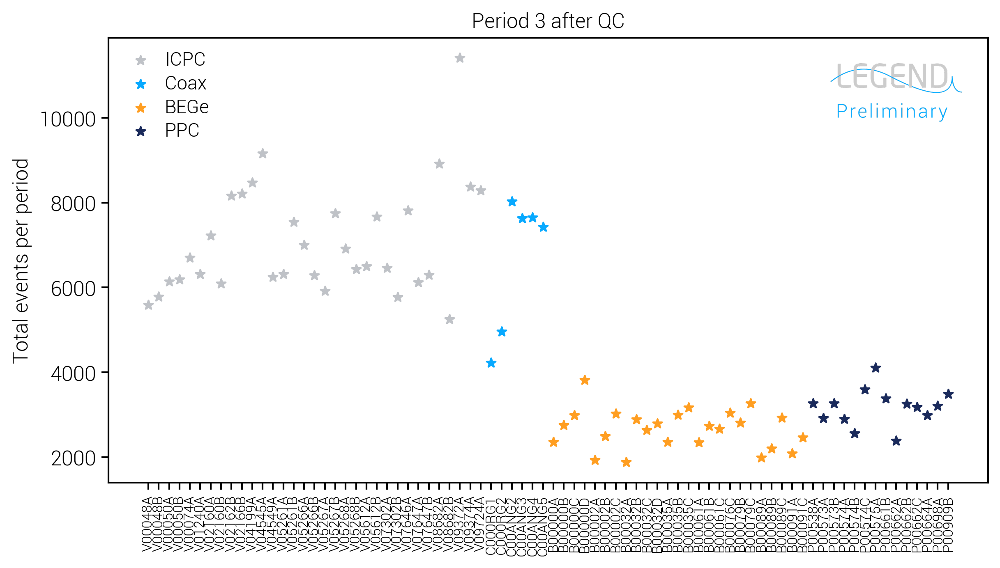

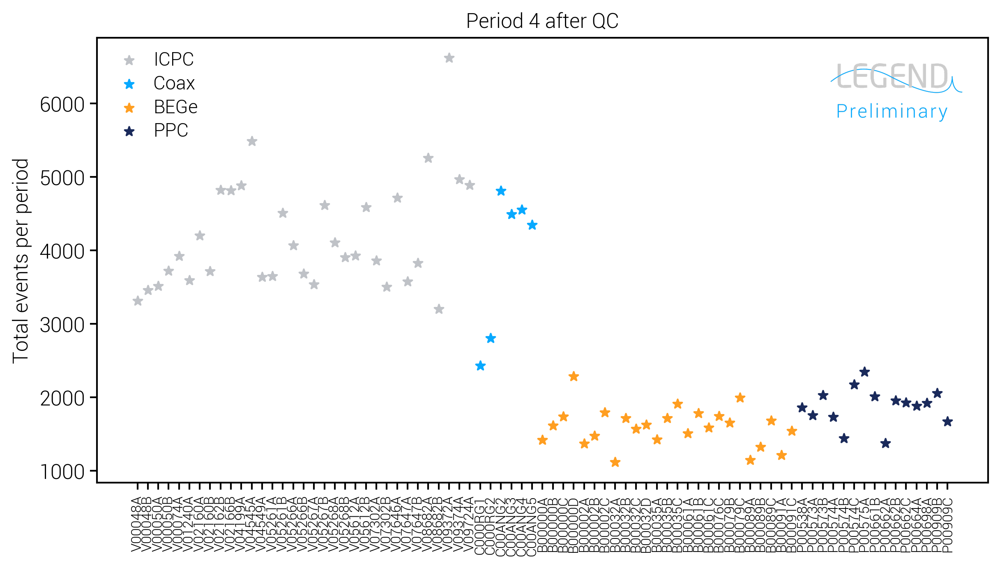

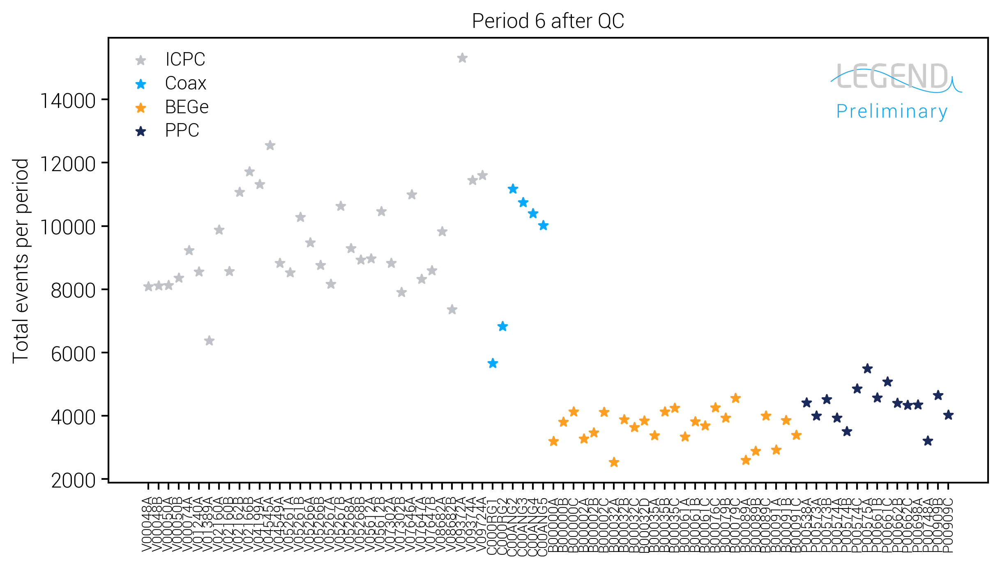

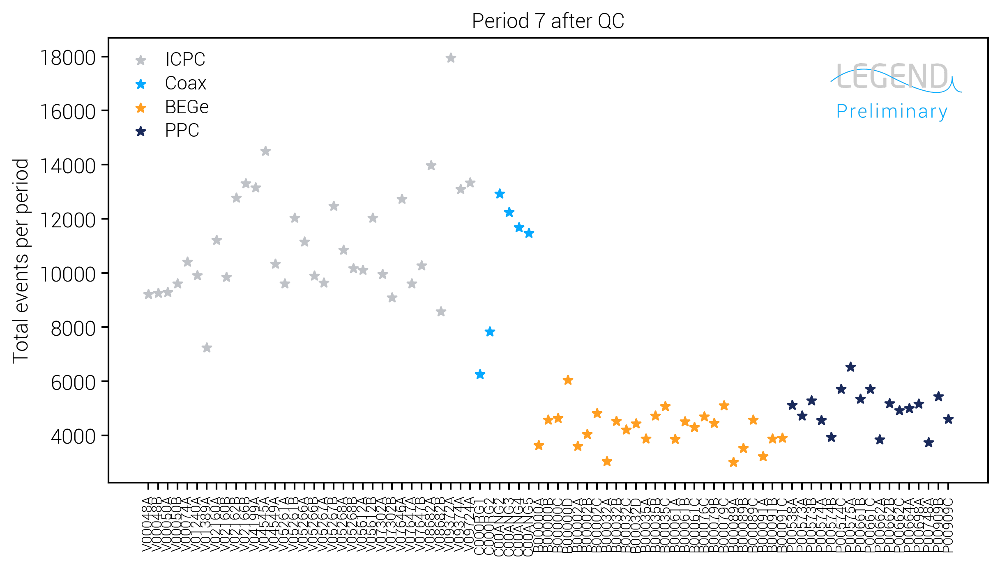

In [48]:
for data_sampl, period in zip([data_p03_filt, data_p04_filt, data_p06_filt, data_p07_filt], [3, 4, 6, 7]):
    fig, ax = lps.subplots()
    for det_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
        det_lab = nice_det_name_dict[det_type]
        subset_data = data_sampl[data_sampl.det_type == det_type]
        channel_counts = subset_data.channel_name.value_counts().sort_index(ascending=True)
        plt.scatter(channel_counts.index, channel_counts, label=det_lab, color=lps.colors[col], marker='*', s=30)
    ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
    plt.xticks(rotation=90, fontsize=8.2)
    plt.title(f'Period {period} after QC')
    plt.ylabel('Total events per period')
    plt.legend()
    plt.show()

In [49]:
def gimme_the_mass_of_this_detector(det_name):
    for vals in channel_dict.values():
        if vals[1]==det_name:
            return vals[2]

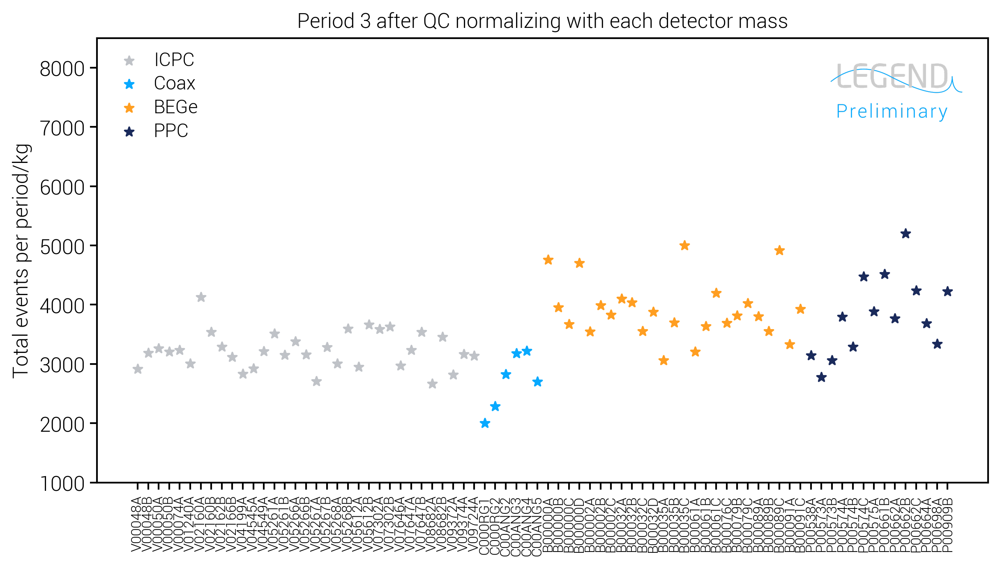

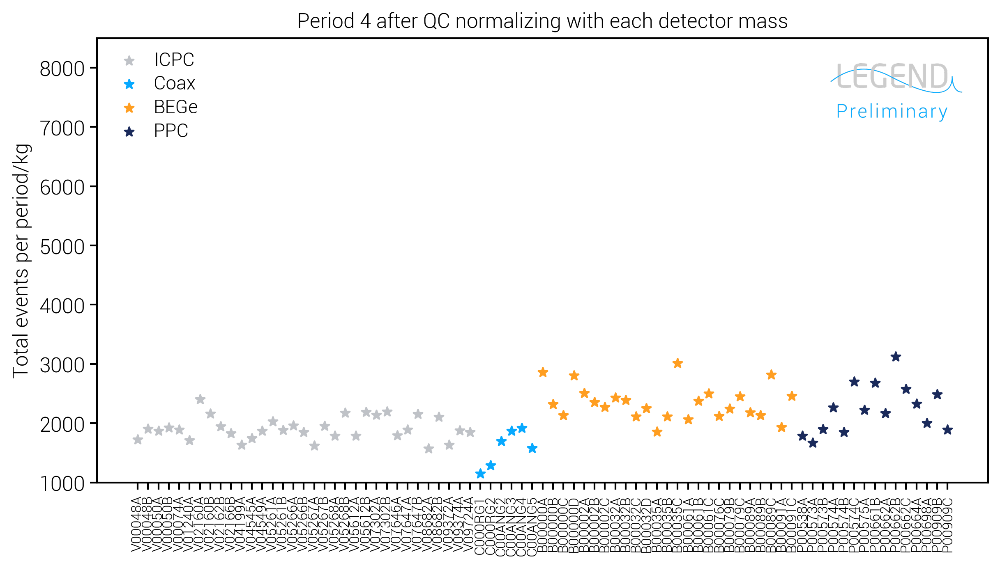

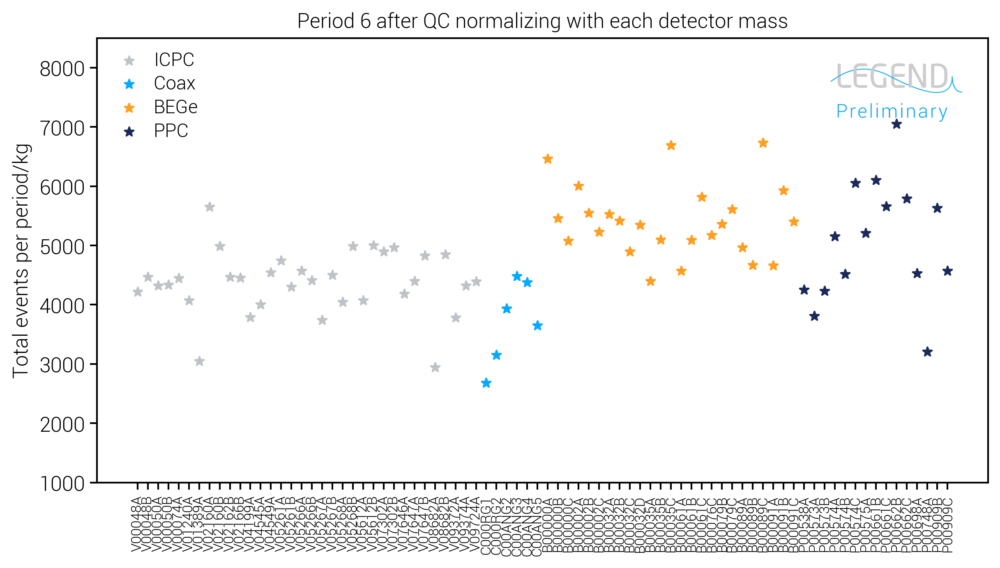

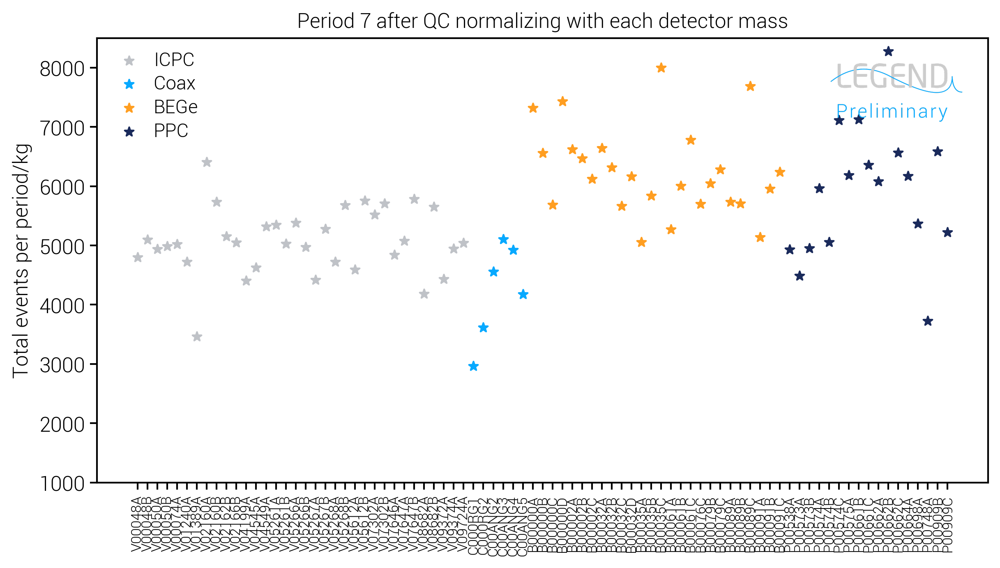

In [50]:
for data_sampl, period in zip([data_p03_filt, data_p04_filt, data_p06_filt, data_p07_filt], [3, 4, 6, 7]):#, [(1000, 7000), (500, 4200)]):
    fig, ax = lps.subplots()
    for det_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
        det_lab = nice_det_name_dict[det_type]
        subset_data = data_sampl[data_sampl.det_type == det_type]
        channel_counts = subset_data.channel_name.value_counts().sort_index(ascending=True)
        det_masses     = np.array([gimme_the_mass_of_this_detector(det) for det in channel_counts.index])/1000 #kg
        plt.scatter(channel_counts.index, channel_counts/det_masses, label=det_lab, color=lps.colors[col], marker='*', s=30)
    ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
    plt.ylim(1000, 8500)
    plt.xticks(rotation=90, fontsize=8.2)
    plt.title(f'Period {period} after QC normalizing with each detector mass')
    plt.ylabel('Total events per period/kg')
    plt.legend()
    plt.show()